# atmodeller

## Tutorial 3b: Monte Carlo experiment

We can devise a simple Monte Carlo (MC) approach to sample the probable atmospheres that can arise for different planetary conditions.

In [319]:
from atmodeller import debug_logger, debug_file_logger
from atmodeller.interior_atmosphere import InteriorAtmosphereSystem, Planet, Species
from atmodeller.constraints import MassConstraint, IronWustiteBufferConstraintHirschmann, SystemConstraints
from atmodeller.interfaces import GasSpecies
from atmodeller.solubilities import PeridotiteH2O, BasaltDixonCO2, BasaltLibourelN2, BasaltDixonH2O, BasaltH2, BasaltCO, BasaltCH4, BasaltS2
from atmodeller.utilities import earth_oceans_to_kg
from atmodeller.initial_condition import InitialConditionRegressor
import numpy as np
import logging

In [320]:
#Plotting Tools:
import matplotlib
import matplotlib.pyplot as plt
plt.rc("savefig", dpi=300)
plt.rc('figure', dpi=300)
#plt.rc('text', usetex=True)
plt.rc('font',**{'family':'serif','serif':['Times']})
#plt.rc('text', usetex=True)
plt.rc('font', size=15)
plt.rc('xtick', direction='in') 
plt.rc('ytick', direction='in')
plt.rc('xtick.major', pad=5) 
plt.rc('xtick.minor', pad=5)
plt.rc('ytick.major', pad=5) 
plt.rc('ytick.minor', pad=5)
plt.rc('lines', dotted_pattern = [0.5, 1.1])

font={'weight':'bold',
     'size': 15}
matplotlib.rc('font', **font)
plt.rcParams["figure.figsize"] = (7,5)



For production runs, make sure to set the logger to INFO or higher (i.e. WARNING, ERROR, or CRITICAL). Otherwise you will find that your MC runs slower just because of writing the output to the logger.

In [322]:
logger = debug_file_logger()
#logger.setLevel(logging.INFO)

We now create the species that we are interested in. Note that we comment out CO2 in this case.

In [35]:
species: Species = Species()
species.append(GasSpecies(formula='H2O'))
species.append(GasSpecies(formula='H2'))
species.append(GasSpecies(formula='O2'))
species.append(GasSpecies(formula='CO'))
species.append(GasSpecies(formula='CO2'))
species.append(GasSpecies(formula='CH4'))
species.append(GasSpecies(formula='N2'))
species.append(GasSpecies(formula='S2'))
#species.append(GasSpecies(formula='Cl2'))
#species.append(GasSpecies(formula='He'))
#species.append(GasSpecies(formula='H2S'))
#species.append(GasSpecies(formula='SO2'))
#species.append(GasSpecies(formula='SO'))
species

[14:03:17 - atmodeller.interfaces          - INFO     ] - Creating GasSpecies H2O using thermodynamic data in JANAF (JANAF name = H2O)
[14:03:17 - atmodeller.interfaces          - INFO     ] - Creating GasSpecies H2 using thermodynamic data in JANAF (JANAF name = H2)
[14:03:17 - atmodeller.interfaces          - INFO     ] - Creating GasSpecies O2 using thermodynamic data in JANAF (JANAF name = O2)
[14:03:17 - atmodeller.interfaces          - INFO     ] - Creating GasSpecies CO using thermodynamic data in JANAF (JANAF name = CO)


[14:03:17 - atmodeller.interfaces          - INFO     ] - Creating GasSpecies CO2 using thermodynamic data in JANAF (JANAF name = CO2)
[14:03:17 - atmodeller.interfaces          - INFO     ] - Creating GasSpecies CH4 using thermodynamic data in JANAF (JANAF name = CH4)
[14:03:17 - atmodeller.interfaces          - INFO     ] - Creating GasSpecies N2 using thermodynamic data in JANAF (JANAF name = N2)
[14:03:17 - atmodeller.interfaces          - INFO     ] - Creating GasSpecies S2 using thermodynamic data in JANAF (JANAF name = S2)


Species([GasSpecies(formula='H2O', thermodynamic_dataset=<atmodeller.interfaces.ThermodynamicDatasetJANAF object at 0x12a1f57d0>, name_in_dataset='H2O', _formula=Formula('H2O'), _thermodynamic_data=ThermodynamicDatasetJANAF.ThermodynamicDataForSpecies(species=..., data_source='JANAF', data=<thermochem.janaf.JanafPhase object at 0x12b4c9550>), _output=None, solubility=<atmodeller.interfaces.NoSolubility object at 0x12a1f7d10>, solid_melt_distribution_coefficient=0, eos=IdealGas(critical_temperature=1, critical_pressure=1, standard_state_pressure=1)),
         GasSpecies(formula='H2', thermodynamic_dataset=<atmodeller.interfaces.ThermodynamicDatasetJANAF object at 0x12b3c1ad0>, name_in_dataset='H2', _formula=Formula('H2'), _thermodynamic_data=ThermodynamicDatasetJANAF.ThermodynamicDataForSpecies(species=..., data_source='JANAF', data=<thermochem.janaf.JanafPhase object at 0x12b1f1610>), _output=None, solubility=<atmodeller.interfaces.NoSolubility object at 0x12b4ca8d0>, solid_melt_distri

Now create a planet. We recall that we can sample different planetary properties by updating the attributes of this object, even though in this tutorial we don't do this.

In [326]:
planet: Planet = Planet(surface_temperature=1500, mantle_mass = 3.249E24, surface_radius = 5.804E6, mantle_melt_fraction=1)

[14:26:06 - atmodeller.interior_atmosphere - INFO     ] - Creating a new planet
[14:26:06 - atmodeller.interior_atmosphere - INFO     ] - Mantle mass (kg) = 3248999999999999788187648.000000
[14:26:06 - atmodeller.interior_atmosphere - INFO     ] - Mantle melt fraction = 1.000000
[14:26:06 - atmodeller.interior_atmosphere - INFO     ] - Core mass fraction = 0.295335
[14:26:06 - atmodeller.interior_atmosphere - INFO     ] - Planetary radius (m) = 5804000.000000
[14:26:06 - atmodeller.interior_atmosphere - INFO     ] - Planetary mass (kg) = 4610699520224821698887680.000000
[14:26:06 - atmodeller.interior_atmosphere - INFO     ] - Surface temperature (K) = 1500.000000
[14:26:06 - atmodeller.interior_atmosphere - INFO     ] - Surface gravity (m/s^2) = 9.135193
[14:26:06 - atmodeller.interior_atmosphere - INFO     ] - Melt Composition = None


In [327]:
#BSE Masses:
mass_H_BSE_min: float = 2.627E20
mass_H_BSE_max: float = 2.687E21

mass_C_BSE_min: float = 2.507E20
mass_C_BSE_max: float = 4.358E21

mass_S_BSE_min: float = 1.194E21
mass_S_BSE_max: float = 1.791E21

mass_N_BSE_min: float = 4.955E18
mass_N_BSE_max: float = 1.4925E19

mass_Cl_BSE: float = 10.4E19
mass_Cl_BSE_low: float = 10.4e18
mass_He_ATM: float = 2.677E15


Now set up the main driver of the Monte Carlo (MC) approach. This establishes the ranges over which we sample certain properties.

In [328]:
def monte_carlo(interior_atmosphere: InteriorAtmosphereSystem, number_of_realisations:int=100):
    """Monte Carlo driver
    
    Args:
        interior_atmosphere: An interior-atmosphere system
        number_of_realisation: Number of simulations to perform
    """

    # Parameters are normally distributed between bounds.
    number_ocean_moles = np.random.uniform(1, 10, number_of_realisations)
    ch_ratios = np.random.uniform(0.1, 1, number_of_realisations)
    fo2_shifts = np.random.uniform(-4, 4, number_of_realisations)

    # ppmw of Nitrogen in the mantle. 2.8 is the mantle value of N.
    #N_ppmw = 2.8

    # The nitrogen mass is constant
    #mass_N = N_ppmw * 1.0e-6 * planet.mantle_mass

    for realisation in range(number_of_realisations):

        mass_H = earth_oceans_to_kg(number_ocean_moles[realisation])
        mass_C = ch_ratios[realisation] * mass_H
        constraints = SystemConstraints([
            MassConstraint(species="H", value=mass_H),
            MassConstraint(species="C", value=mass_C),
            MassConstraint(species="N", value=mass_N_BSE_min),
            MassConstraint(species="S", value=mass_S_BSE_min),
            IronWustiteBufferConstraintHirschmann(log10_shift=fo2_shifts[realisation])
        ])

        # Extra quantities to write to the output
        # For example, it's often helpful to have the constraints expressed in a more convenient
        # form for analysis and plotting.
        extra = {'fO2_shift': fo2_shifts[realisation], 'C/H ratio':ch_ratios[realisation],
            'Number of ocean moles':number_ocean_moles[realisation]}

        interior_atmosphere.solve(constraints, extra_output=extra, factor=0.1)


We can run the MC as follows. This may take a minute or two to run.

In [39]:
interior_atmosphere: InteriorAtmosphereSystem = InteriorAtmosphereSystem(species=species, planet=planet)
monte_carlo(interior_atmosphere)

[14:03:32 - atmodeller.initial_condition   - INFO     ] - Creating InitialConditionConstant
[14:03:32 - atmodeller.interior_atmosphere - INFO     ] - Creating an interior-atmosphere system
[14:03:32 - atmodeller.interior_atmosphere - INFO     ] - Creating a reaction network
[14:03:32 - atmodeller.interior_atmosphere - INFO     ] - Species = ['H2O', 'H2', 'O2', 'CO', 'CO2', 'CH4', 'N2', 'S2']
[14:03:32 - atmodeller.interior_atmosphere - INFO     ] - Reactions = 
{0: '2.0 H2O + 4.0 CO = 3.0 CO2 + 1.0 CH4',
 1: '1.0 H2O + 1.0 CO = 1.0 H2 + 1.0 CO2',
 2: '2.0 CO2 = 1.0 O2 + 2.0 CO'}
[14:03:32 - atmodeller.interior_atmosphere - INFO     ] - Solving system number 0
[14:03:34 - atmodeller.interior_atmosphere - INFO     ] - The solution converged.
[14:03:34 - atmodeller.interior_atmosphere - INFO     ] - InitialConditionConstant: RMSE (actual vs initial) = 1.857683534246873
[14:03:34 - atmodeller.interior_atmosphere - INFO     ] - {'CH4': 0.0002575354095328111,
 'CO': 2.7064338923348323,
 'CO2

The simulation data can be exported to an Excel or a pickle file by setting the appropriate keyword argument in the output method:

In [40]:
interior_atmosphere.output(file_prefix='T1e_1500K_CHONS', to_pickle=True, to_excel=True)

[20:44:19 - atmodeller.output              - INFO     ] - Output written to T1e_1500K_CHONS.pkl
[20:44:20 - atmodeller.output              - INFO     ] - Output written to T1e_1500K_CHONS.xlsx


{'atmosphere': [{'total_pressure': 1002.910930996016,
   'mean_molar_mass': 0.022677919687889722},
  {'total_pressure': 2487.8343130856915,
   'mean_molar_mass': 0.02029881048641397},
  {'total_pressure': 1494.4004769722178,
   'mean_molar_mass': 0.011629390759611152},
  {'total_pressure': 2686.154202828741,
   'mean_molar_mass': 0.021493467425082707},
  {'total_pressure': 466.66869334483096,
   'mean_molar_mass': 0.012002268677371458},
  {'total_pressure': 824.7928233093023,
   'mean_molar_mass': 0.02229959099817316},
  {'total_pressure': 445.7650443538573,
   'mean_molar_mass': 0.017970484409996962},
  {'total_pressure': 2168.7057349917086,
   'mean_molar_mass': 0.014386311353313967},
  {'total_pressure': 2513.760852440533,
   'mean_molar_mass': 0.020607712096354595},
  {'total_pressure': 1157.2193773263782,
   'mean_molar_mass': 0.0086647970379744},
  {'total_pressure': 408.91763186780065,
   'mean_molar_mass': 0.010265481675303284},
  {'total_pressure': 1126.9973832033954,
   'mean

We now want to use the simpler system solved above to inform the initial condition for a more complex system. Here, we now include CO2 as a species, although in principle we could include any number of extra species or even remove species compared to the previous species list. Also, we note that the species list does not have to be in the same order as before.

In [329]:
species: Species = Species()
species.append(GasSpecies(formula='H2O', solubility=BasaltDixonH2O()))
species.append(GasSpecies(formula='H2', solubility=BasaltH2()))
species.append(GasSpecies(formula='O2'))
species.append(GasSpecies(formula='CO', solubility=BasaltCO()))
species.append(GasSpecies(formula='CO2', solubility=BasaltDixonCO2()))
species.append(GasSpecies(formula='CH4', solubility=BasaltCH4()))
species.append(GasSpecies(formula='N2', solubility=BasaltLibourelN2()))
species.append(GasSpecies(formula='S2', solubility=BasaltS2()))
species.append(GasSpecies(formula='H2S'))
species.append(GasSpecies(formula='SO2'))
species.append(GasSpecies(formula='SO'))
species

[14:26:18 - atmodeller.interfaces          - INFO     ] - Creating GasSpecies H2O using thermodynamic data in JANAF (JANAF name = H2O)
[14:26:18 - atmodeller.interfaces          - INFO     ] - Creating GasSpecies H2 using thermodynamic data in JANAF (JANAF name = H2)
[14:26:18 - atmodeller.interfaces          - INFO     ] - Creating GasSpecies O2 using thermodynamic data in JANAF (JANAF name = O2)
[14:26:18 - atmodeller.interfaces          - INFO     ] - Creating GasSpecies CO using thermodynamic data in JANAF (JANAF name = CO)
[14:26:18 - atmodeller.interfaces          - INFO     ] - Creating GasSpecies CO2 using thermodynamic data in JANAF (JANAF name = CO2)
[14:26:18 - atmodeller.interfaces          - INFO     ] - Creating GasSpecies CH4 using thermodynamic data in JANAF (JANAF name = CH4)
[14:26:18 - atmodeller.interfaces          - INFO     ] - Creating GasSpecies N2 using thermodynamic data in JANAF (JANAF name = N2)
[14:26:19 - atmodeller.interfaces          - INFO     ] - Creat

Species([GasSpecies(formula='H2O', thermodynamic_dataset=<atmodeller.interfaces.ThermodynamicDatasetJANAF object at 0x14f271590>, name_in_dataset='H2O', _formula=Formula('H2O'), _thermodynamic_data=ThermodynamicDatasetJANAF.ThermodynamicDataForSpecies(species=..., data_source='JANAF', data=<thermochem.janaf.JanafPhase object at 0x14f040390>), _output=None, solubility=<atmodeller.solubilities.BasaltDixonH2O object at 0x14f2702d0>, solid_melt_distribution_coefficient=0, eos=IdealGas(critical_temperature=1, critical_pressure=1, standard_state_pressure=1)),
         GasSpecies(formula='H2', thermodynamic_dataset=<atmodeller.interfaces.ThermodynamicDatasetJANAF object at 0x14f1c3b90>, name_in_dataset='H2', _formula=Formula('H2'), _thermodynamic_data=ThermodynamicDatasetJANAF.ThermodynamicDataForSpecies(species=..., data_source='JANAF', data=<thermochem.janaf.JanafPhase object at 0x14ec02d10>), _output=None, solubility=<atmodeller.solubilities.BasaltH2 object at 0x14f271950>, solid_melt_dist

In the new species list above, we also specify CO2.  Hence in the below we must provide a fill value to use for CO2 because the original data has no notion of CO2. In the below, we set the initial CO2 pressure to 1 bar.

In [330]:
#initial_condition = InitialConditionRegressor.from_pickle('T1e_1500K_CHONS_AllIdeal_HCNSSol_2000its_2.pkl', species=species, fit=True, fit_batch_size=250, partial_fit=True, partial_fit_batch_size=100)

initial_condition = InitialConditionRegressor.from_pickle('T1e_1500K_CHONS_AllIdeal_HCNSSol_2000its_2.pkl', species=species, fit=False, partial_fit=True, partial_fit_batch_size=200)

[14:26:21 - atmodeller.output              - INFO     ] - Output: Reading data from T1e_1500K_CHONS_AllIdeal_HCNSSol_2000its_2.pkl
[14:26:21 - atmodeller.initial_condition   - INFO     ] - Creating InitialConditionRegressor


[14:26:21 - atmodeller.initial_condition   - INFO     ] - InitialConditionRegressor: Fit (None, None)
[14:26:22 - atmodeller.initial_condition   - INFO     ] - InitialConditionRegressor: Found constraints = ['H_mass', 'C_mass', 'N_mass', 'S_mass', 'O2_fugacity']
[14:26:22 - atmodeller.initial_condition   - INFO     ] - InitialConditionRegressor: Found species = ['H2O', 'H2', 'O2', 'CO', 'CO2', 'CH4', 'N2', 'S2', 'H2S', 'SO2', 'SO']


In the above, fit = True, which means the trained data from the previous run (as computed from the output in the pickle file) is only used for the first fit_batch_size = 100 simulations. Subsequently the regressor will re-train itself on just the (fit_batch_size = 100) samples generated from the current model, discarding knowledge of the previous data it was trained on. Then, every partial_fit_batch_size = 100 simulations, it will update its training with the last batch of newly generated samples in order to better inform the selection of subsequent initial conditions. This is known as a dynamic or online learning approach.

It is necessary to pass the initial condition to the interior atmosphere system when it is created:

In [331]:
interior_atmosphere_ic: InteriorAtmosphereSystem = InteriorAtmosphereSystem(species=species, initial_condition=initial_condition, planet=planet)
monte_carlo(interior_atmosphere_ic, number_of_realisations=5000)

[14:26:31 - atmodeller.interior_atmosphere - INFO     ] - Creating an interior-atmosphere system
[14:26:31 - atmodeller.interior_atmosphere - INFO     ] - Creating a reaction network
[14:26:31 - atmodeller.interior_atmosphere - INFO     ] - Species = ['H2O', 'H2', 'O2', 'CO', 'CO2', 'CH4', 'N2', 'S2', 'H2S', 'SO2', 'SO']
[14:26:31 - atmodeller.interior_atmosphere - INFO     ] - Reactions = 
{0: '4.0 H2 + 1.0 CO2 = 2.0 H2O + 1.0 CH4',
 1: '2.0 H2O = 2.0 H2 + 1.0 O2',
 2: '1.0 H2 + 1.0 CO2 = 1.0 H2O + 1.0 CO',
 3: '1.0 H2 + 0.5 S2 = 1.0 H2S',
 4: '2.0 H2O + 0.5 S2 = 2.0 H2 + 1.0 SO2',
 5: '1.0 H2O + 0.5 S2 = 1.0 H2 + 1.0 SO'}
[14:26:31 - atmodeller.interior_atmosphere - INFO     ] - Solving system number 0
[14:26:39 - atmodeller.interior_atmosphere - INFO     ] - The solution converged.
[14:26:39 - atmodeller.interior_atmosphere - INFO     ] - InitialConditionRegressor: RMSE (actual vs initial) = 0.09424205558405724
[14:26:39 - atmodeller.interior_atmosphere - INFO     ] - {'CH4': 2.9685

SystemExit: 

/Users/maggiethompson/Programs/atmodeller/.venv/lib/python3.11/site-packages/IPython/core/interactiveshell.py:3516: UserWarning: To exit: use 'exit', 'quit', or Ctrl-D.
  warn("To exit: use 'exit', 'quit', or Ctrl-D.", stacklevel=1)


In [332]:
interior_atmosphere_ic.output(file_prefix='T1e_1500K_CHONS_AllIdeal_HCNSSol_2000_4', to_pickle=True, to_excel=True)

[17:39:07 - atmodeller.output              - INFO     ] - Output written to T1e_1500K_CHONS_AllIdeal_HCNSSol_2000_4.pkl
[17:39:11 - atmodeller.output              - INFO     ] - Output written to T1e_1500K_CHONS_AllIdeal_HCNSSol_2000_4.xlsx


{'atmosphere': [{'total_pressure': 83.55359595183394,
   'mean_molar_mass': 0.04000815048205728},
  {'total_pressure': 338.1035024020222,
   'mean_molar_mass': 0.04136316010269223},
  {'total_pressure': 167.24394283320927,
   'mean_molar_mass': 0.03567707240044605},
  {'total_pressure': 90.08711432823895,
   'mean_molar_mass': 0.03859315132641162},
  {'total_pressure': 361.5216170384983,
   'mean_molar_mass': 0.04195145135530961},
  {'total_pressure': 178.3012329113796,
   'mean_molar_mass': 0.009585942445209746},
  {'total_pressure': 202.27969114113097,
   'mean_molar_mass': 0.023323160856620884},
  {'total_pressure': 407.67737166220786,
   'mean_molar_mass': 0.025241540985337485},
  {'total_pressure': 606.5799641736954,
   'mean_molar_mass': 0.043218384544500124},
  {'total_pressure': 163.19578899076436,
   'mean_molar_mass': 0.030984211191604584},
  {'total_pressure': 181.16833675625807,
   'mean_molar_mass': 0.02531337832692581},
  {'total_pressure': 362.9566847562904,
   'mean_mol

If you compare the log output for the two MC runs, you will see in the second MC example that the initial condition re-trained itself after 100 samples had been generated and then partially retrained itself every 50 samples. This keeps the RMSE between the initial guess and actual solution to a smaller value than simply guessing a constant initial condition. Also, fit = True allows you to train an initial condition on a similar but not identical model (for example, different solubility laws or gas equations of states), where once enough samples have been generated you would prefer to only use the new model to generate new estimates (since the behavior of the new model and the previous similar-but-not-the-same model will diverge).

In [32]:
from sklearn.neighbors import NearestNeighbors
import pandas as pd
def monte_carlo_nearestneighbors(interior_atmosphere: InteriorAtmosphereSystem, number_of_realisations:int=100):
    """Monte Carlo driver
    
    Args:
        interior_atmosphere: An interior-atmosphere system
        number_of_realisation: Number of simulations to perform
    """

    # Parameters are normally distributed between bounds.
    number_ocean_moles = np.random.uniform(1, 10, number_of_realisations)
    ch_ratios = np.random.uniform(0.1, 1, number_of_realisations)
    fo2_shifts = np.random.uniform(-4, 4, number_of_realisations)

    for realisation in range(number_of_realisations):

        mass_H = earth_oceans_to_kg(number_ocean_moles[realisation])
        mass_C = ch_ratios[realisation] * mass_H
        constraints = SystemConstraints([
            MassConstraint(species="H", value=mass_H),
            MassConstraint(species="C", value=mass_C),
            MassConstraint(species="N", value=mass_N_BSE_min),
            MassConstraint(species="S", value=mass_S_BSE_min),
            IronWustiteBufferConstraintHirschmann(log10_shift=fo2_shifts[realisation])
        ])
        datafile_fO2: str = f"T1e_1500K_CHONS_AllIdeal_HCNSSol_2000its_forNN.csv"
        df_fO2: pd.DataFrame = pd.read_csv(datafile_fO2, skiprows=1, names=('index', 'H2O_pp', 'H2_pp', 'O2_pp', 'CO_pp', 'CO2_pp', 'CH4_pp', 'N2_pp', 'S2_pp', 'H2S_pp', 'SO2_pp', 'SO_pp', 'fO2_shift','ch_ratio','number_ocean_moles'))

        constraints_data = np.array([df_fO2.fO2_shift, df_fO2.number_ocean_moles, df_fO2.ch_ratio])
        constraint_vals = np.array([fo2_shifts[realisation], number_ocean_moles[realisation], ch_ratios[realisation]])
        #print(constraint_vals)
        #Given current constraints, find closest match in dataset:

        neigh = NearestNeighbors(n_neighbors=1)
        neigh.fit(constraints_data.T)
        NearestNeighbors(n_neighbors=1)
        closest_val =(neigh.kneighbors([constraint_vals]))

        close_match = closest_val[1].reshape(1).flatten().tolist()
        initial_sol = [df_fO2.loc[close_match].H2O_pp.values[0], df_fO2.loc[close_match].H2_pp.values[0], df_fO2.loc[close_match].O2_pp.values[0], df_fO2.loc[close_match].CO_pp.values[0], 
                   df_fO2.loc[close_match].CO2_pp.values[0], df_fO2.loc[close_match].CH4_pp.values[0], df_fO2.loc[close_match].N2_pp.values[0], df_fO2.loc[close_match].S2_pp.values[0], 
                   df_fO2.loc[close_match].H2S_pp.values[0], df_fO2.loc[close_match].SO2_pp.values[0],df_fO2.loc[close_match].SO_pp.values[0]]
    #initial_sol = [10, 10, 1e-10, 10, 10, 1, 0.1, 1e-4,10,10,10]
    

        # Extra quantities to write to the output
        # For example, it's often helpful to have the constraints expressed in a more convenient
        # form for analysis and plotting.
        extra = {'fO2_shift': fo2_shifts[realisation], 'C/H ratio':ch_ratios[realisation],
            'Number of ocean moles':number_ocean_moles[realisation]}

        interior_atmosphere.solve(constraints, extra_output=extra, factor=0.1)

In [34]:
interior_atmosphere_NN: InteriorAtmosphereSystem = InteriorAtmosphereSystem(species=species, planet=planet)
monte_carlo_nearestneighbors(interior_atmosphere_NN, number_of_realisations=100)

[20:10:02 - atmodeller.initial_condition   - INFO     ] - Creating InitialConditionConstant
[20:10:02 - atmodeller.interior_atmosphere - INFO     ] - Creating an interior-atmosphere system
[20:10:02 - atmodeller.interior_atmosphere - INFO     ] - Creating a reaction network
[20:10:02 - atmodeller.interior_atmosphere - INFO     ] - Species = ['H2O', 'H2', 'O2', 'CO', 'CO2', 'CH4', 'N2', 'S2', 'H2S', 'SO2', 'SO']
[20:10:02 - atmodeller.interior_atmosphere - INFO     ] - Reactions = 
{0: '2.0 H2O + 4.0 CO = 3.0 CO2 + 1.0 CH4',
 1: '1.0 H2O + 1.0 CO = 1.0 H2 + 1.0 CO2',
 2: '2.0 CO2 = 1.0 O2 + 2.0 CO',
 3: '1.0 H2O + 1.0 CO + 0.5 S2 = 1.0 CO2 + 1.0 H2S',
 4: '2.0 CO2 + 0.5 S2 = 2.0 CO + 1.0 SO2',
 5: '1.0 CO2 + 0.5 S2 = 1.0 CO + 1.0 SO'}


[20:10:03 - atmodeller.interior_atmosphere - INFO     ] - Solving system number 0
[20:10:03 - atmodeller.interfaces          - WARNING  ] - BasaltS2_Sulfide solubility (10974 ppmw) will be limited to 10000 ppmw
[20:10:03 - atmodeller.interfaces          - WARNING  ] - BasaltS2 solubility (10000 ppmw) will be limited to 10000 ppmw
[20:10:03 - atmodeller.interfaces          - WARNING  ] - BasaltS2_Sulfide solubility (10974 ppmw) will be limited to 10000 ppmw
[20:10:03 - atmodeller.interfaces          - WARNING  ] - BasaltS2 solubility (10000 ppmw) will be limited to 10000 ppmw
[20:10:03 - atmodeller.interfaces          - WARNING  ] - BasaltS2_Sulfide solubility (10974 ppmw) will be limited to 10000 ppmw
[20:10:03 - atmodeller.interfaces          - WARNING  ] - BasaltS2 solubility (10000 ppmw) will be limited to 10000 ppmw
[20:10:03 - atmodeller.interfaces          - WARNING  ] - BasaltS2_Sulfide solubility (10974 ppmw) will be limited to 10000 ppmw
[20:10:03 - atmodeller.interfaces      

SystemExit: 

/Users/maggiethompson/Programs/atmodeller/.venv/lib/python3.11/site-packages/IPython/core/interactiveshell.py:3516: UserWarning: To exit: use 'exit', 'quit', or Ctrl-D.
  warn("To exit: use 'exit', 'quit', or Ctrl-D.", stacklevel=1)


In [35]:
datafile_fO2: str = f"T1e_1500K_CHONS_AllIdeal_HCNSSol_2000its_forNN.csv"
df_fO2: pd.DataFrame = pd.read_csv(datafile_fO2, skiprows=1, names=('index', 'H2O_pp', 'H2_pp', 'O2_pp', 'CO_pp', 'CO2_pp', 'CH4_pp', 'N2_pp', 'S2_pp', 'H2S_pp', 'SO2_pp', 'SO_pp', 'fO2_shift','ch_ratio','number_ocean_moles'))

constraints_data = np.array([df_fO2.fO2_shift, df_fO2.number_ocean_moles, df_fO2.ch_ratio])
constraint_vals = np.array([-1, 8, 0.5])
#print(constraint_vals)
#Given current constraints, find closest match in dataset:

neigh = NearestNeighbors(n_neighbors=1)
neigh.fit(constraints_data.T)
NearestNeighbors(n_neighbors=1)
closest_val =(neigh.kneighbors([constraint_vals]))

close_match = closest_val[1].reshape(1).flatten().tolist()
initial_sol = [df_fO2.loc[close_match].H2O_pp.values[0], df_fO2.loc[close_match].H2_pp.values[0], df_fO2.loc[close_match].O2_pp.values[0], df_fO2.loc[close_match].CO_pp.values[0], 
                   df_fO2.loc[close_match].CO2_pp.values[0], df_fO2.loc[close_match].CH4_pp.values[0], df_fO2.loc[close_match].N2_pp.values[0], df_fO2.loc[close_match].S2_pp.values[0], 
                   df_fO2.loc[close_match].H2S_pp.values[0], df_fO2.loc[close_match].SO2_pp.values[0],df_fO2.loc[close_match].SO_pp.values[0]]


In [39]:
print(close_match)
print(df_fO2.loc[close_match].fO2_shift.values[0])
print(df_fO2.loc[close_match].number_ocean_moles.values[0])
print(df_fO2.loc[close_match].ch_ratio.values[0])


[1067]
-0.864332411
7.967985566
0.434446851


# Plotting

In [3]:
import pandas as pd

T1e_NoSols = pd.ExcelFile('T1e_1500K_CHONS_AllIdeal_NoSols_3800.xlsx')
T1e_NoSols_atmo = pd.read_excel(T1e_NoSols, 'atmosphere')
T1e_NoSols_constraints = pd.read_excel(T1e_NoSols, 'constraints')
T1e_NoSols_planet = pd.read_excel(T1e_NoSols, 'planet')
T1e_NoSols_H2O = pd.read_excel(T1e_NoSols, 'H2O')
T1e_NoSols_H2 = pd.read_excel(T1e_NoSols, 'H2')
T1e_NoSols_O2 = pd.read_excel(T1e_NoSols, 'O2')
T1e_NoSols_CO = pd.read_excel(T1e_NoSols, 'CO')
T1e_NoSols_CO2 = pd.read_excel(T1e_NoSols, 'CO2')
T1e_NoSols_CH4 = pd.read_excel(T1e_NoSols, 'CH4')
T1e_NoSols_N2 = pd.read_excel(T1e_NoSols, 'N2')
T1e_NoSols_S2 = pd.read_excel(T1e_NoSols, 'S2')
T1e_NoSols_H2S = pd.read_excel(T1e_NoSols, 'H2S')
T1e_NoSols_SO2 = pd.read_excel(T1e_NoSols, 'SO2')
T1e_NoSols_SO = pd.read_excel(T1e_NoSols, 'SO')
T1e_NoSols_soln = pd.read_excel(T1e_NoSols, 'solution')
T1e_NoSols_constraints = pd.read_excel(T1e_NoSols, 'constraints')
T1e_NoSols_extra = pd.read_excel(T1e_NoSols, 'extra')





/var/folders/48/rykhh41s6ds_xk4143_5pyv00000gn/T/ipykernel_19203/36407727.py:366: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


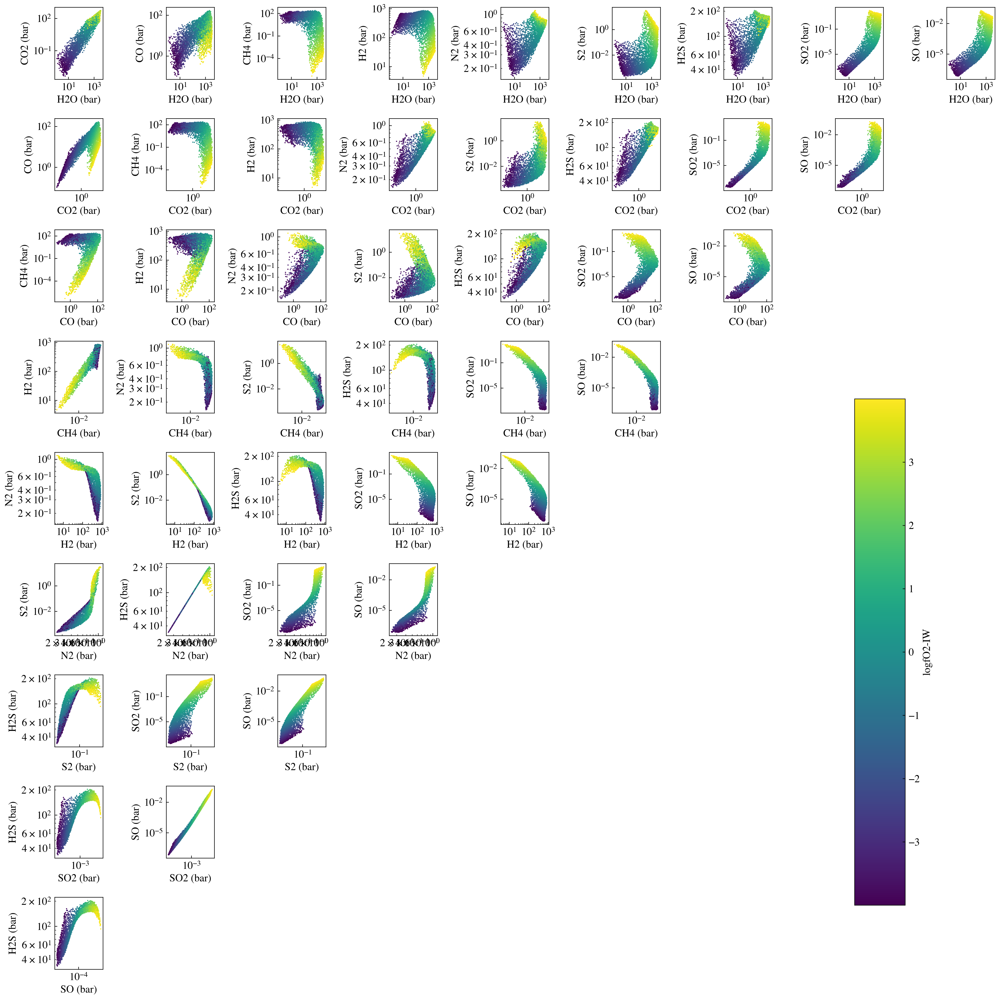

In [12]:

fig, ax = plt.subplots(figsize=(20, 20), ncols=9, nrows=9)

#colormap = plt.cm.get_cmap('RdYlGn') # 'plasma' or 'viridis'
colors=T1e_NoSols_extra.fO2_shift
#H2O-CO2
ax[0,0].scatter(T1e_NoSols_soln.H2O, T1e_NoSols_soln.CO2, c=colors, s=0.5)
ax[0,0].set_xscale('log')
ax[0,0].set_yscale('log')
ax[0,0].set_xlabel('H2O (bar)')
ax[0,0].set_ylabel('CO2 (bar)')

#H2O-CO
ax[0,1].scatter(T1e_NoSols_soln.H2O, T1e_NoSols_soln.CO, c=colors, s=0.5)
ax[0,1].set_xscale('log')
ax[0,1].set_yscale('log')
ax[0,1].set_xlabel('H2O (bar)')
ax[0,1].set_ylabel('CO (bar)')

#H2O-CH4
ax[0,2].scatter(T1e_NoSols_soln.H2O, T1e_NoSols_soln.CH4, c=colors, s=0.5)
ax[0,2].set_xscale('log')
ax[0,2].set_yscale('log')
ax[0,2].set_xlabel('H2O (bar)')
ax[0,2].set_ylabel('CH4 (bar)')

#H2O-H2
ax[0,3].scatter(T1e_NoSols_soln.H2O, T1e_NoSols_soln.H2, c=colors, s=0.5)
ax[0,3].set_xscale('log')
ax[0,3].set_yscale('log')
ax[0,3].set_xlabel('H2O (bar)')
ax[0,3].set_ylabel('H2 (bar)')

#H2O-N2
ax[0,4].scatter(T1e_NoSols_soln.H2O, T1e_NoSols_soln.N2, c=colors, s=0.5)
ax[0,4].set_xscale('log')
ax[0,4].set_yscale('log')
ax[0,4].set_xlabel('H2O (bar)')
ax[0,4].set_ylabel('N2 (bar)')

#H2O-S2
ax[0,5].scatter(T1e_NoSols_soln.H2O, T1e_NoSols_soln.S2, c=colors, s=0.5)
ax[0,5].set_xscale('log')
ax[0,5].set_yscale('log')
ax[0,5].set_xlabel('H2O (bar)')
ax[0,5].set_ylabel('S2 (bar)')

#H2O-H2S
ax[0,6].scatter(T1e_NoSols_soln.H2O, T1e_NoSols_soln.H2S, c=colors, s=0.5)
ax[0,6].set_xscale('log')
ax[0,6].set_yscale('log')
ax[0,6].set_xlabel('H2O (bar)')
ax[0,6].set_ylabel('H2S (bar)')

#H2O-SO2
ax[0,7].scatter(T1e_NoSols_soln.H2O, T1e_NoSols_soln.SO2, c=colors, s=0.5)
ax[0,7].set_xscale('log')
ax[0,7].set_yscale('log')
ax[0,7].set_xlabel('H2O (bar)')
ax[0,7].set_ylabel('SO2 (bar)')

#H2O-SO
ax[0,8].scatter(T1e_NoSols_soln.H2O, T1e_NoSols_soln.SO, c=colors, s=0.5)
ax[0,8].set_xscale('log')
ax[0,8].set_yscale('log')
ax[0,8].set_xlabel('H2O (bar)')
ax[0,8].set_ylabel('SO (bar)')

#CO2-CO
ax[1,0].scatter(T1e_NoSols_soln.CO2, T1e_NoSols_soln.CO, c=colors, s=0.5)
ax[1,0].set_xscale('log')
ax[1,0].set_yscale('log')
ax[1,0].set_xlabel('CO2 (bar)')
ax[1,0].set_ylabel('CO (bar)')

#CO2-CH4
ax[1,1].scatter(T1e_NoSols_soln.CO2, T1e_NoSols_soln.CH4, c=colors, s=0.5)
ax[1,1].set_xscale('log')
ax[1,1].set_yscale('log')
ax[1,1].set_xlabel('CO2 (bar)')
ax[1,1].set_ylabel('CH4 (bar)')

#CO2-H2
ax[1,2].scatter(T1e_NoSols_soln.CO2, T1e_NoSols_soln.H2, c=colors, s=0.5)
ax[1,2].set_xscale('log')
ax[1,2].set_yscale('log')
ax[1,2].set_xlabel('CO2 (bar)')
ax[1,2].set_ylabel('H2 (bar)')

#CO2-N2
ax[1,3].scatter(T1e_NoSols_soln.CO2, T1e_NoSols_soln.N2, c=colors, s=0.5)
ax[1,3].set_xscale('log')
ax[1,3].set_yscale('log')
ax[1,3].set_xlabel('CO2 (bar)')
ax[1,3].set_ylabel('N2 (bar)')

#CO2-S2
ax[1,4].scatter(T1e_NoSols_soln.CO2, T1e_NoSols_soln.S2, c=colors, s=0.5)
ax[1,4].set_xscale('log')
ax[1,4].set_yscale('log')
ax[1,4].set_xlabel('CO2 (bar)')
ax[1,4].set_ylabel('S2 (bar)')

#CO2-H2S
ax[1,5].scatter(T1e_NoSols_soln.CO2, T1e_NoSols_soln.H2S, c=colors, s=0.5)
ax[1,5].set_xscale('log')
ax[1,5].set_yscale('log')
ax[1,5].set_xlabel('CO2 (bar)')
ax[1,5].set_ylabel('H2S (bar)')

#CO2-SO2
ax[1,6].scatter(T1e_NoSols_soln.CO2, T1e_NoSols_soln.SO2, c=colors, s=0.5)
ax[1,6].set_xscale('log')
ax[1,6].set_yscale('log')
ax[1,6].set_xlabel('CO2 (bar)')
ax[1,6].set_ylabel('SO2 (bar)')

#CO2-SO
ax[1,7].scatter(T1e_NoSols_soln.CO2, T1e_NoSols_soln.SO, c=colors, s=0.5)
ax[1,7].set_xscale('log')
ax[1,7].set_yscale('log')
ax[1,7].set_xlabel('CO2 (bar)')
ax[1,7].set_ylabel('SO (bar)')

#CO-CH4
ax[2,0].scatter(T1e_NoSols_soln.CO, T1e_NoSols_soln.CH4, c=colors, s=0.5)
ax[2,0].set_xscale('log')
ax[2,0].set_yscale('log')
ax[2,0].set_xlabel('CO (bar)')
ax[2,0].set_ylabel('CH4 (bar)')

#CO-H2
ax[2,1].scatter(T1e_NoSols_soln.CO, T1e_NoSols_soln.H2, c=colors, s=0.5)
ax[2,1].set_xscale('log')
ax[2,1].set_yscale('log')
ax[2,1].set_xlabel('CO (bar)')
ax[2,1].set_ylabel('H2 (bar)')

#CO-N2
ax[2,2].scatter(T1e_NoSols_soln.CO, T1e_NoSols_soln.N2, c=colors, s=0.5)
ax[2,2].set_xscale('log')
ax[2,2].set_yscale('log')
ax[2,2].set_xlabel('CO (bar)')
ax[2,2].set_ylabel('N2 (bar)')

#CO-S2
ax[2,3].scatter(T1e_NoSols_soln.CO, T1e_NoSols_soln.S2, c=colors, s=0.5)
ax[2,3].set_xscale('log')
ax[2,3].set_yscale('log')
ax[2,3].set_xlabel('CO (bar)')
ax[2,3].set_ylabel('S2 (bar)')

#CO-H2S
ax[2,4].scatter(T1e_NoSols_soln.CO, T1e_NoSols_soln.H2S, c=colors, s=0.5)
ax[2,4].set_xscale('log')
ax[2,4].set_yscale('log')
ax[2,4].set_xlabel('CO (bar)')
ax[2,4].set_ylabel('H2S (bar)')
                   
#CO-SO2
ax[2,5].scatter(T1e_NoSols_soln.CO, T1e_NoSols_soln.SO2, c=colors, s=0.5)
ax[2,5].set_xscale('log')
ax[2,5].set_yscale('log')
ax[2,5].set_xlabel('CO (bar)')
ax[2,5].set_ylabel('SO2 (bar)')

#CO-SO
ax[2,6].scatter(T1e_NoSols_soln.CO, T1e_NoSols_soln.SO, c=colors, s=0.5)
ax[2,6].set_xscale('log')
ax[2,6].set_yscale('log')
ax[2,6].set_xlabel('CO (bar)')
ax[2,6].set_ylabel('SO (bar)')

#CH4-H2
ax[3,0].scatter(T1e_NoSols_soln.CH4, T1e_NoSols_soln.H2, c=colors, s=0.5)
ax[3,0].set_xscale('log')
ax[3,0].set_yscale('log')
ax[3,0].set_xlabel('CH4 (bar)')
ax[3,0].set_ylabel('H2 (bar)')

#CH4-N2
ax[3,1].scatter(T1e_NoSols_soln.CH4, T1e_NoSols_soln.N2, c=colors, s=0.5)
ax[3,1].set_xscale('log')
ax[3,1].set_yscale('log')
ax[3,1].set_xlabel('CH4 (bar)')
ax[3,1].set_ylabel('N2 (bar)')

#CH4-S2
ax[3,2].scatter(T1e_NoSols_soln.CH4, T1e_NoSols_soln.S2, c=colors, s=0.5)
ax[3,2].set_xscale('log')
ax[3,2].set_yscale('log')
ax[3,2].set_xlabel('CH4 (bar)')
ax[3,2].set_ylabel('S2 (bar)')

#CH4-H2S
ax[3,3].scatter(T1e_NoSols_soln.CH4, T1e_NoSols_soln.H2S, c=colors, s=0.5)
ax[3,3].set_xscale('log')
ax[3,3].set_yscale('log')
ax[3,3].set_xlabel('CH4 (bar)')
ax[3,3].set_ylabel('H2S (bar)')

#CH4-SO2
ax[3,4].scatter(T1e_NoSols_soln.CH4, T1e_NoSols_soln.SO2, c=colors, s=0.5)
ax[3,4].set_xscale('log')
ax[3,4].set_yscale('log')
ax[3,4].set_xlabel('CH4 (bar)')
ax[3,4].set_ylabel('SO2 (bar)')

#CH4-SO
ax[3,5].scatter(T1e_NoSols_soln.CH4, T1e_NoSols_soln.SO, c=colors, s=0.5)
ax[3,5].set_xscale('log')
ax[3,5].set_yscale('log')
ax[3,5].set_xlabel('CH4 (bar)')
ax[3,5].set_ylabel('SO (bar)')

#H2-N2
sc = ax[4,0].scatter(T1e_NoSols_soln.H2, T1e_NoSols_soln.N2, c=colors, s=0.5)
ax[4,0].set_xscale('log')
ax[4,0].set_yscale('log')
ax[4,0].set_xlabel('H2 (bar)')
ax[4,0].set_ylabel('N2 (bar)')

#H2-S2
sc = ax[4,1].scatter(T1e_NoSols_soln.H2, T1e_NoSols_soln.S2, c=colors, s=0.5)
ax[4,1].set_xscale('log')
ax[4,1].set_yscale('log')
ax[4,1].set_xlabel('H2 (bar)')
ax[4,1].set_ylabel('S2 (bar)')

#H2-H2S
sc = ax[4,2].scatter(T1e_NoSols_soln.H2, T1e_NoSols_soln.H2S, c=colors, s=0.5)
ax[4,2].set_xscale('log')
ax[4,2].set_yscale('log')
ax[4,2].set_xlabel('H2 (bar)')
ax[4,2].set_ylabel('H2S (bar)')

#H2-SO2
sc = ax[4,3].scatter(T1e_NoSols_soln.H2, T1e_NoSols_soln.SO2, c=colors, s=0.5)
ax[4,3].set_xscale('log')
ax[4,3].set_yscale('log')
ax[4,3].set_xlabel('H2 (bar)')
ax[4,3].set_ylabel('SO2 (bar)')

#H2-SO
sc = ax[4,4].scatter(T1e_NoSols_soln.H2, T1e_NoSols_soln.SO, c=colors, s=0.5)
ax[4,4].set_xscale('log')
ax[4,4].set_yscale('log')
ax[4,4].set_xlabel('H2 (bar)')
ax[4,4].set_ylabel('SO (bar)')

#N2-S2
sc = ax[5,0].scatter(T1e_NoSols_soln.N2, T1e_NoSols_soln.S2, c=colors, s=0.5)
ax[5,0].set_xscale('log')
ax[5,0].set_yscale('log')
ax[5,0].set_xlabel('N2 (bar)')
ax[5,0].set_ylabel('S2 (bar)')

#N2-H2S
sc = ax[5,1].scatter(T1e_NoSols_soln.N2, T1e_NoSols_soln.H2S, c=colors, s=0.5)
ax[5,1].set_xscale('log')
ax[5,1].set_yscale('log')
ax[5,1].set_xlabel('N2 (bar)')
ax[5,1].set_ylabel('H2S (bar)')

#N2-SO2
sc = ax[5,2].scatter(T1e_NoSols_soln.N2, T1e_NoSols_soln.SO2, c=colors, s=0.5)
ax[5,2].set_xscale('log')
ax[5,2].set_yscale('log')
ax[5,2].set_xlabel('N2 (bar)')
ax[5,2].set_ylabel('SO2 (bar)')

#N2-SO
sc = ax[5,3].scatter(T1e_NoSols_soln.N2, T1e_NoSols_soln.SO, c=colors, s=0.5)
ax[5,3].set_xscale('log')
ax[5,3].set_yscale('log')
ax[5,3].set_xlabel('N2 (bar)')
ax[5,3].set_ylabel('SO (bar)')

#S2-H2S
sc = ax[6,0].scatter(T1e_NoSols_soln.S2, T1e_NoSols_soln.H2S, c=colors, s=0.5)
ax[6,0].set_xscale('log')
ax[6,0].set_yscale('log')
ax[6,0].set_xlabel('S2 (bar)')
ax[6,0].set_ylabel('H2S (bar)')

#S2-SO2
sc = ax[6,1].scatter(T1e_NoSols_soln.S2, T1e_NoSols_soln.SO2, c=colors, s=0.5)
ax[6,1].set_xscale('log')
ax[6,1].set_yscale('log')
ax[6,1].set_xlabel('S2 (bar)')
ax[6,1].set_ylabel('SO2 (bar)')

#S2-SO
sc = ax[6,2].scatter(T1e_NoSols_soln.S2, T1e_NoSols_soln.SO, c=colors, s=0.5)
ax[6,2].set_xscale('log')
ax[6,2].set_yscale('log')
ax[6,2].set_xlabel('S2 (bar)')
ax[6,2].set_ylabel('SO (bar)')

#SO2-H2S
sc = ax[7,0].scatter(T1e_NoSols_soln.SO2, T1e_NoSols_soln.H2S, c=colors, s=0.5)
ax[7,0].set_xscale('log')
ax[7,0].set_yscale('log')
ax[7,0].set_xlabel('SO2 (bar)')
ax[7,0].set_ylabel('H2S (bar)')

#SO2-SO
sc = ax[7,1].scatter(T1e_NoSols_soln.SO2, T1e_NoSols_soln.SO, c=colors, s=0.5)
ax[7,1].set_xscale('log')
ax[7,1].set_yscale('log')
ax[7,1].set_xlabel('SO2 (bar)')
ax[7,1].set_ylabel('SO (bar)')

#SO-H2S
sc = ax[8,0].scatter(T1e_NoSols_soln.SO, T1e_NoSols_soln.H2S, c=colors, s=0.5)
ax[8,0].set_xscale('log')
ax[8,0].set_yscale('log')
ax[8,0].set_xlabel('SO (bar)')
ax[8,0].set_ylabel('H2S (bar)')

ax[1, 8].axis('off')
ax[2, 7].axis('off')
ax[2, 8].axis('off')
ax[3, 6].axis('off')
ax[3, 7].axis('off')
ax[3, 8].axis('off')
ax[4, 5].axis('off')
ax[4, 6].axis('off')
ax[4, 7].axis('off')
ax[4, 8].axis('off')

ax[5, 4].axis('off')
ax[5, 5].axis('off')
ax[5, 6].axis('off')
ax[5, 7].axis('off')
ax[5, 8].axis('off')

ax[6, 3].axis('off')
ax[6, 4].axis('off')
ax[6, 5].axis('off')
ax[6, 6].axis('off')
ax[6, 7].axis('off')
ax[6, 8].axis('off')

ax[7, 2].axis('off')
ax[7, 3].axis('off')
ax[7, 4].axis('off')
ax[7, 5].axis('off')
ax[7, 6].axis('off')
ax[7, 7].axis('off')
ax[7, 8].axis('off')
ax[8, 1].axis('off')
ax[8, 2].axis('off')
ax[8, 3].axis('off')
ax[8, 4].axis('off')
ax[8, 5].axis('off')
ax[8, 6].axis('off')
ax[8, 7].axis('off')
ax[8, 8].axis('off')



fig.subplots_adjust(right=0.8)
cbar_ax = fig.add_axes([0.85, 0.10, 0.05, 0.5])
fig.colorbar(sc, cax=cbar_ax, label='logfO2-IW')

fig.tight_layout()
#plt.savefig("Plots/T1e_HCON_1500K_MF1_3800_logscale.jpg", dpi=1000)
plt.show()

/var/folders/48/rykhh41s6ds_xk4143_5pyv00000gn/T/ipykernel_19203/496089322.py:276: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


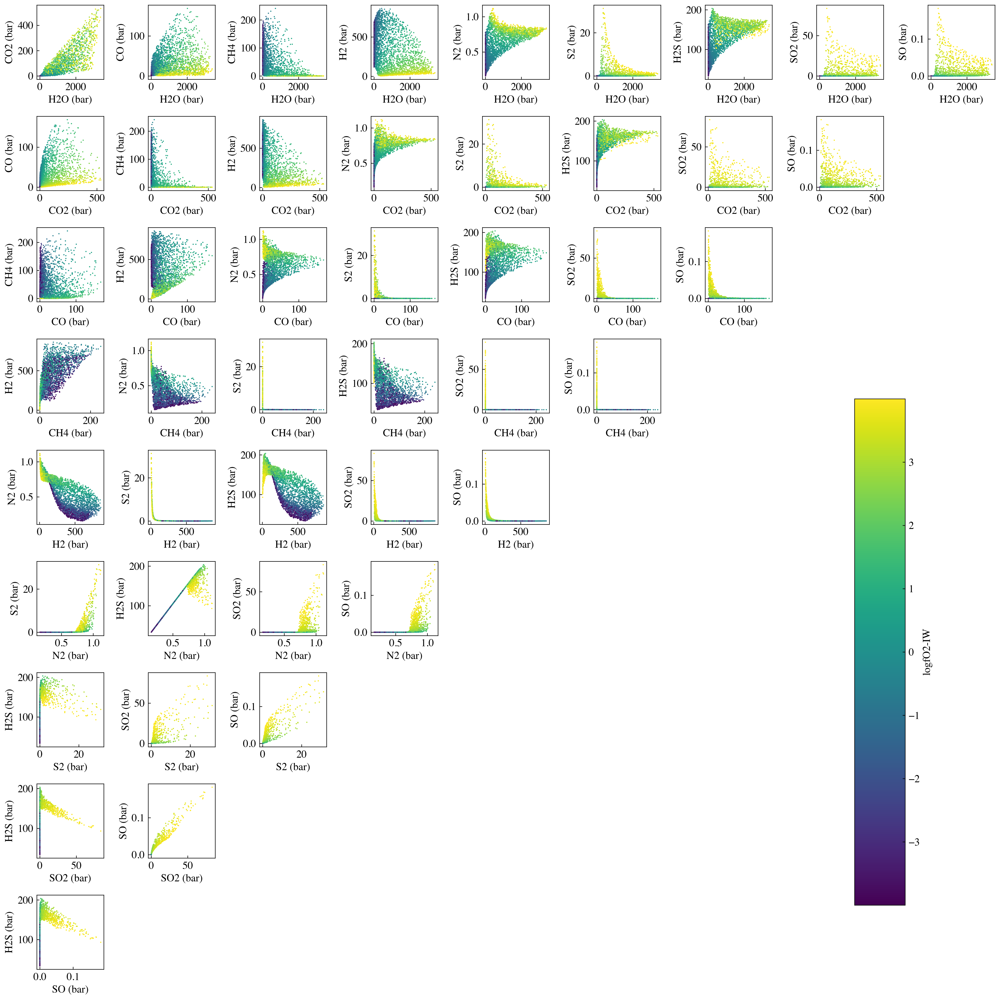

In [16]:

fig, ax = plt.subplots(figsize=(20, 20), ncols=9, nrows=9)

#colormap = plt.cm.get_cmap('RdYlGn') # 'plasma' or 'viridis'
colors=T1e_NoSols_extra.fO2_shift
#H2O-CO2
ax[0,0].scatter(T1e_NoSols_soln.H2O, T1e_NoSols_soln.CO2, c=colors, s=0.5)
ax[0,0].set_xlabel('H2O (bar)')
ax[0,0].set_ylabel('CO2 (bar)')

#H2O-CO
ax[0,1].scatter(T1e_NoSols_soln.H2O, T1e_NoSols_soln.CO, c=colors, s=0.5)
ax[0,1].set_xlabel('H2O (bar)')
ax[0,1].set_ylabel('CO (bar)')

#H2O-CH4
ax[0,2].scatter(T1e_NoSols_soln.H2O, T1e_NoSols_soln.CH4, c=colors, s=0.5)
ax[0,2].set_xlabel('H2O (bar)')
ax[0,2].set_ylabel('CH4 (bar)')

#H2O-H2
ax[0,3].scatter(T1e_NoSols_soln.H2O, T1e_NoSols_soln.H2, c=colors, s=0.5)
ax[0,3].set_xlabel('H2O (bar)')
ax[0,3].set_ylabel('H2 (bar)')

#H2O-N2
ax[0,4].scatter(T1e_NoSols_soln.H2O, T1e_NoSols_soln.N2, c=colors, s=0.5)
ax[0,4].set_xlabel('H2O (bar)')
ax[0,4].set_ylabel('N2 (bar)')

#H2O-S2
ax[0,5].scatter(T1e_NoSols_soln.H2O, T1e_NoSols_soln.S2, c=colors, s=0.5)
ax[0,5].set_xlabel('H2O (bar)')
ax[0,5].set_ylabel('S2 (bar)')

#H2O-H2S
ax[0,6].scatter(T1e_NoSols_soln.H2O, T1e_NoSols_soln.H2S, c=colors, s=0.5)
ax[0,6].set_xlabel('H2O (bar)')
ax[0,6].set_ylabel('H2S (bar)')

#H2O-SO2
ax[0,7].scatter(T1e_NoSols_soln.H2O, T1e_NoSols_soln.SO2, c=colors, s=0.5)
ax[0,7].set_xlabel('H2O (bar)')
ax[0,7].set_ylabel('SO2 (bar)')

#H2O-SO
ax[0,8].scatter(T1e_NoSols_soln.H2O, T1e_NoSols_soln.SO, c=colors, s=0.5)
ax[0,8].set_xlabel('H2O (bar)')
ax[0,8].set_ylabel('SO (bar)')

#CO2-CO
ax[1,0].scatter(T1e_NoSols_soln.CO2, T1e_NoSols_soln.CO, c=colors, s=0.5)
ax[1,0].set_xlabel('CO2 (bar)')
ax[1,0].set_ylabel('CO (bar)')

#CO2-CH4
ax[1,1].scatter(T1e_NoSols_soln.CO2, T1e_NoSols_soln.CH4, c=colors, s=0.5)
ax[1,1].set_xlabel('CO2 (bar)')
ax[1,1].set_ylabel('CH4 (bar)')

#CO2-H2
ax[1,2].scatter(T1e_NoSols_soln.CO2, T1e_NoSols_soln.H2, c=colors, s=0.5)
ax[1,2].set_xlabel('CO2 (bar)')
ax[1,2].set_ylabel('H2 (bar)')

#CO2-N2
ax[1,3].scatter(T1e_NoSols_soln.CO2, T1e_NoSols_soln.N2, c=colors, s=0.5)
ax[1,3].set_xlabel('CO2 (bar)')
ax[1,3].set_ylabel('N2 (bar)')

#CO2-S2
ax[1,4].scatter(T1e_NoSols_soln.CO2, T1e_NoSols_soln.S2, c=colors, s=0.5)
ax[1,4].set_xlabel('CO2 (bar)')
ax[1,4].set_ylabel('S2 (bar)')

#CO2-H2S
ax[1,5].scatter(T1e_NoSols_soln.CO2, T1e_NoSols_soln.H2S, c=colors, s=0.5)
ax[1,5].set_xlabel('CO2 (bar)')
ax[1,5].set_ylabel('H2S (bar)')

#CO2-SO2
ax[1,6].scatter(T1e_NoSols_soln.CO2, T1e_NoSols_soln.SO2, c=colors, s=0.5)
ax[1,6].set_xlabel('CO2 (bar)')
ax[1,6].set_ylabel('SO2 (bar)')

#CO2-SO
ax[1,7].scatter(T1e_NoSols_soln.CO2, T1e_NoSols_soln.SO, c=colors, s=0.5)
ax[1,7].set_xlabel('CO2 (bar)')
ax[1,7].set_ylabel('SO (bar)')

#CO-CH4
ax[2,0].scatter(T1e_NoSols_soln.CO, T1e_NoSols_soln.CH4, c=colors, s=0.5)
ax[2,0].set_xlabel('CO (bar)')
ax[2,0].set_ylabel('CH4 (bar)')

#CO-H2
ax[2,1].scatter(T1e_NoSols_soln.CO, T1e_NoSols_soln.H2, c=colors, s=0.5)
ax[2,1].set_xlabel('CO (bar)')
ax[2,1].set_ylabel('H2 (bar)')

#CO-N2
ax[2,2].scatter(T1e_NoSols_soln.CO, T1e_NoSols_soln.N2, c=colors, s=0.5)
ax[2,2].set_xlabel('CO (bar)')
ax[2,2].set_ylabel('N2 (bar)')

#CO-S2
ax[2,3].scatter(T1e_NoSols_soln.CO, T1e_NoSols_soln.S2, c=colors, s=0.5)
ax[2,3].set_xlabel('CO (bar)')
ax[2,3].set_ylabel('S2 (bar)')

#CO-H2S
ax[2,4].scatter(T1e_NoSols_soln.CO, T1e_NoSols_soln.H2S, c=colors, s=0.5)
ax[2,4].set_xlabel('CO (bar)')
ax[2,4].set_ylabel('H2S (bar)')
                   
#CO-SO2
ax[2,5].scatter(T1e_NoSols_soln.CO, T1e_NoSols_soln.SO2, c=colors, s=0.5)
ax[2,5].set_xlabel('CO (bar)')
ax[2,5].set_ylabel('SO2 (bar)')

#CO-SO
ax[2,6].scatter(T1e_NoSols_soln.CO, T1e_NoSols_soln.SO, c=colors, s=0.5)
ax[2,6].set_xlabel('CO (bar)')
ax[2,6].set_ylabel('SO (bar)')

#CH4-H2
ax[3,0].scatter(T1e_NoSols_soln.CH4, T1e_NoSols_soln.H2, c=colors, s=0.5)
ax[3,0].set_xlabel('CH4 (bar)')
ax[3,0].set_ylabel('H2 (bar)')

#CH4-N2
ax[3,1].scatter(T1e_NoSols_soln.CH4, T1e_NoSols_soln.N2, c=colors, s=0.5)
ax[3,1].set_xlabel('CH4 (bar)')
ax[3,1].set_ylabel('N2 (bar)')

#CH4-S2
ax[3,2].scatter(T1e_NoSols_soln.CH4, T1e_NoSols_soln.S2, c=colors, s=0.5)
ax[3,2].set_xlabel('CH4 (bar)')
ax[3,2].set_ylabel('S2 (bar)')

#CH4-H2S
ax[3,3].scatter(T1e_NoSols_soln.CH4, T1e_NoSols_soln.H2S, c=colors, s=0.5)
ax[3,3].set_xlabel('CH4 (bar)')
ax[3,3].set_ylabel('H2S (bar)')

#CH4-SO2
ax[3,4].scatter(T1e_NoSols_soln.CH4, T1e_NoSols_soln.SO2, c=colors, s=0.5)
ax[3,4].set_xlabel('CH4 (bar)')
ax[3,4].set_ylabel('SO2 (bar)')

#CH4-SO
ax[3,5].scatter(T1e_NoSols_soln.CH4, T1e_NoSols_soln.SO, c=colors, s=0.5)
ax[3,5].set_xlabel('CH4 (bar)')
ax[3,5].set_ylabel('SO (bar)')

#H2-N2
sc = ax[4,0].scatter(T1e_NoSols_soln.H2, T1e_NoSols_soln.N2, c=colors, s=0.5)
ax[4,0].set_xlabel('H2 (bar)')
ax[4,0].set_ylabel('N2 (bar)')

#H2-S2
sc = ax[4,1].scatter(T1e_NoSols_soln.H2, T1e_NoSols_soln.S2, c=colors, s=0.5)
ax[4,1].set_xlabel('H2 (bar)')
ax[4,1].set_ylabel('S2 (bar)')

#H2-H2S
sc = ax[4,2].scatter(T1e_NoSols_soln.H2, T1e_NoSols_soln.H2S, c=colors, s=0.5)
ax[4,2].set_xlabel('H2 (bar)')
ax[4,2].set_ylabel('H2S (bar)')

#H2-SO2
sc = ax[4,3].scatter(T1e_NoSols_soln.H2, T1e_NoSols_soln.SO2, c=colors, s=0.5)
ax[4,3].set_xlabel('H2 (bar)')
ax[4,3].set_ylabel('SO2 (bar)')

#H2-SO
sc = ax[4,4].scatter(T1e_NoSols_soln.H2, T1e_NoSols_soln.SO, c=colors, s=0.5)
ax[4,4].set_xlabel('H2 (bar)')
ax[4,4].set_ylabel('SO (bar)')

#N2-S2
sc = ax[5,0].scatter(T1e_NoSols_soln.N2, T1e_NoSols_soln.S2, c=colors, s=0.5)
ax[5,0].set_xlabel('N2 (bar)')
ax[5,0].set_ylabel('S2 (bar)')

#N2-H2S
sc = ax[5,1].scatter(T1e_NoSols_soln.N2, T1e_NoSols_soln.H2S, c=colors, s=0.5)
ax[5,1].set_xlabel('N2 (bar)')
ax[5,1].set_ylabel('H2S (bar)')

#N2-SO2
sc = ax[5,2].scatter(T1e_NoSols_soln.N2, T1e_NoSols_soln.SO2, c=colors, s=0.5)
ax[5,2].set_xlabel('N2 (bar)')
ax[5,2].set_ylabel('SO2 (bar)')

#N2-SO
sc = ax[5,3].scatter(T1e_NoSols_soln.N2, T1e_NoSols_soln.SO, c=colors, s=0.5)
ax[5,3].set_xlabel('N2 (bar)')
ax[5,3].set_ylabel('SO (bar)')

#S2-H2S
sc = ax[6,0].scatter(T1e_NoSols_soln.S2, T1e_NoSols_soln.H2S, c=colors, s=0.5)
ax[6,0].set_xlabel('S2 (bar)')
ax[6,0].set_ylabel('H2S (bar)')

#S2-SO2
sc = ax[6,1].scatter(T1e_NoSols_soln.S2, T1e_NoSols_soln.SO2, c=colors, s=0.5)
ax[6,1].set_xlabel('S2 (bar)')
ax[6,1].set_ylabel('SO2 (bar)')

#S2-SO
sc = ax[6,2].scatter(T1e_NoSols_soln.S2, T1e_NoSols_soln.SO, c=colors, s=0.5)
ax[6,2].set_xlabel('S2 (bar)')
ax[6,2].set_ylabel('SO (bar)')

#SO2-H2S
sc = ax[7,0].scatter(T1e_NoSols_soln.SO2, T1e_NoSols_soln.H2S, c=colors, s=0.5)
ax[7,0].set_xlabel('SO2 (bar)')
ax[7,0].set_ylabel('H2S (bar)')

#SO2-SO
sc = ax[7,1].scatter(T1e_NoSols_soln.SO2, T1e_NoSols_soln.SO, c=colors, s=0.5)
ax[7,1].set_xlabel('SO2 (bar)')
ax[7,1].set_ylabel('SO (bar)')

#SO-H2S
sc = ax[8,0].scatter(T1e_NoSols_soln.SO, T1e_NoSols_soln.H2S, c=colors, s=0.5)
ax[8,0].set_xlabel('SO (bar)')
ax[8,0].set_ylabel('H2S (bar)')

ax[1, 8].axis('off')
ax[2, 7].axis('off')
ax[2, 8].axis('off')
ax[3, 6].axis('off')
ax[3, 7].axis('off')
ax[3, 8].axis('off')
ax[4, 5].axis('off')
ax[4, 6].axis('off')
ax[4, 7].axis('off')
ax[4, 8].axis('off')

ax[5, 4].axis('off')
ax[5, 5].axis('off')
ax[5, 6].axis('off')
ax[5, 7].axis('off')
ax[5, 8].axis('off')

ax[6, 3].axis('off')
ax[6, 4].axis('off')
ax[6, 5].axis('off')
ax[6, 6].axis('off')
ax[6, 7].axis('off')
ax[6, 8].axis('off')

ax[7, 2].axis('off')
ax[7, 3].axis('off')
ax[7, 4].axis('off')
ax[7, 5].axis('off')
ax[7, 6].axis('off')
ax[7, 7].axis('off')
ax[7, 8].axis('off')
ax[8, 1].axis('off')
ax[8, 2].axis('off')
ax[8, 3].axis('off')
ax[8, 4].axis('off')
ax[8, 5].axis('off')
ax[8, 6].axis('off')
ax[8, 7].axis('off')
ax[8, 8].axis('off')



fig.subplots_adjust(right=0.8)
cbar_ax = fig.add_axes([0.85, 0.10, 0.05, 0.5])
fig.colorbar(sc, cax=cbar_ax, label='logfO2-IW')

fig.tight_layout()
plt.savefig("Plots/T1e_HCONS_1500K_MF1_3800_linscale.jpg", dpi=1000)
plt.show()

In [71]:
def plot_pressures(file_soln, file_extra, filename, title):
    
    fig, ax = plt.subplots(figsize=(20, 20), ncols=9, nrows=9)
    #colormap = plt.cm.get_cmap('RdYlGn') # 'plasma' or 'viridis'
    colors=file_extra.fO2_shift
        #H2O-CO2
    ax[0,0].scatter(file_soln.H2O, file_soln.CO2, c=colors, s=0.5)
    ax[0,0].set_xlabel('H2O (bar)')
    ax[0,0].set_ylabel('CO2 (bar)')

    #H2O-CO
    ax[0,1].scatter(file_soln.H2O, file_soln.CO, c=colors, s=0.5)
    ax[0,1].set_xlabel('H2O (bar)')
    ax[0,1].set_ylabel('CO (bar)')

    #H2O-CH4
    ax[0,2].scatter(file_soln.H2O, file_soln.CH4, c=colors, s=0.5)
    ax[0,2].set_xlabel('H2O (bar)')
    ax[0,2].set_ylabel('CH4 (bar)')

    #H2O-H2
    ax[0,3].scatter(file_soln.H2O, file_soln.H2, c=colors, s=0.5)
    ax[0,3].set_xlabel('H2O (bar)')
    ax[0,3].set_ylabel('H2 (bar)')

    #H2O-N2
    ax[0,4].scatter(file_soln.H2O, file_soln.N2, c=colors, s=0.5)
    ax[0,4].set_xlabel('H2O (bar)')
    ax[0,4].set_ylabel('N2 (bar)')

    #H2O-S2
    ax[0,5].scatter(file_soln.H2O,  file_soln.S2, c=colors, s=0.5)
    ax[0,5].set_xlabel('H2O (bar)')
    ax[0,5].set_ylabel('S2 (bar)')

    #H2O-H2S
    ax[0,6].scatter(file_soln.H2O, file_soln.H2S, c=colors, s=0.5)
    ax[0,6].set_xlabel('H2O (bar)')
    ax[0,6].set_ylabel('H2S (bar)')

    #H2O-SO2
    ax[0,7].scatter(file_soln.H2O, file_soln.SO2, c=colors, s=0.5)
    ax[0,7].set_xlabel('H2O (bar)')
    ax[0,7].set_ylabel('SO2 (bar)')

    #H2O-SO
    ax[0,8].scatter(file_soln.H2O, file_soln.SO, c=colors, s=0.5)
    ax[0,8].set_xlabel('H2O (bar)')
    ax[0,8].set_ylabel('SO (bar)')

    #CO2-CO
    ax[1,0].scatter(file_soln.CO2, file_soln.CO, c=colors, s=0.5)
    ax[1,0].set_xlabel('CO2 (bar)')
    ax[1,0].set_ylabel('CO (bar)')

    #CO2-CH4
    ax[1,1].scatter(file_soln.CO2, file_soln.CH4, c=colors, s=0.5)
    ax[1,1].set_xlabel('CO2 (bar)')
    ax[1,1].set_ylabel('CH4 (bar)')

    #CO2-H2
    ax[1,2].scatter(file_soln.CO2, file_soln.H2, c=colors, s=0.5)
    ax[1,2].set_xlabel('CO2 (bar)')
    ax[1,2].set_ylabel('H2 (bar)')

    #CO2-N2
    ax[1,3].scatter(file_soln.CO2, file_soln.N2, c=colors, s=0.5)
    ax[1,3].set_xlabel('CO2 (bar)')
    ax[1,3].set_ylabel('N2 (bar)')

    #CO2-S2
    ax[1,4].scatter(file_soln.CO2, file_soln.S2, c=colors, s=0.5)
    ax[1,4].set_xlabel('CO2 (bar)')
    ax[1,4].set_ylabel('S2 (bar)')

    #CO2-H2S
    ax[1,5].scatter(file_soln.CO2, file_soln.H2S, c=colors, s=0.5)
    ax[1,5].set_xlabel('CO2 (bar)')
    ax[1,5].set_ylabel('H2S (bar)')

    #CO2-SO2
    ax[1,6].scatter(file_soln.CO2, file_soln.SO2, c=colors, s=0.5)
    ax[1,6].set_xlabel('CO2 (bar)')
    ax[1,6].set_ylabel('SO2 (bar)')

    #CO2-SO
    ax[1,7].scatter(file_soln.CO2, file_soln.SO, c=colors, s=0.5)
    ax[1,7].set_xlabel('CO2 (bar)')
    ax[1,7].set_ylabel('SO (bar)')

    #CO-CH4
    ax[2,0].scatter(file_soln.CO, file_soln.CH4, c=colors, s=0.5)
    ax[2,0].set_xlabel('CO (bar)')
    ax[2,0].set_ylabel('CH4 (bar)')

    #CO-H2
    ax[2,1].scatter(file_soln.CO, file_soln.H2, c=colors, s=0.5)
    ax[2,1].set_xlabel('CO (bar)')
    ax[2,1].set_ylabel('H2 (bar)')

    #CO-N2
    ax[2,2].scatter(file_soln.CO, file_soln.N2, c=colors, s=0.5)
    ax[2,2].set_xlabel('CO (bar)')
    ax[2,2].set_ylabel('N2 (bar)')

    #CO-S2
    ax[2,3].scatter(file_soln.CO, file_soln.S2, c=colors, s=0.5)
    ax[2,3].set_xlabel('CO (bar)')
    ax[2,3].set_ylabel('S2 (bar)')

    #CO-H2S
    ax[2,4].scatter(file_soln.CO, file_soln.H2S, c=colors, s=0.5)
    ax[2,4].set_xlabel('CO (bar)')
    ax[2,4].set_ylabel('H2S (bar)')
                    
    #CO-SO2
    ax[2,5].scatter(file_soln.CO, file_soln.SO2, c=colors, s=0.5)
    ax[2,5].set_xlabel('CO (bar)')
    ax[2,5].set_ylabel('SO2 (bar)')

    #CO-SO
    ax[2,6].scatter(file_soln.CO, file_soln.SO, c=colors, s=0.5)
    ax[2,6].set_xlabel('CO (bar)')
    ax[2,6].set_ylabel('SO (bar)')

    #CH4-H2
    ax[3,0].scatter(file_soln.CH4, file_soln.H2, c=colors, s=0.5)
    ax[3,0].set_xlabel('CH4 (bar)')
    ax[3,0].set_ylabel('H2 (bar)')

    #CH4-N2
    ax[3,1].scatter(file_soln.CH4, file_soln.N2, c=colors, s=0.5)
    ax[3,1].set_xlabel('CH4 (bar)')
    ax[3,1].set_ylabel('N2 (bar)')

    #CH4-S2
    ax[3,2].scatter(file_soln.CH4, file_soln.S2, c=colors, s=0.5)
    ax[3,2].set_xlabel('CH4 (bar)')
    ax[3,2].set_ylabel('S2 (bar)')

    #CH4-H2S
    ax[3,3].scatter(file_soln.CH4, file_soln.H2S, c=colors, s=0.5)
    ax[3,3].set_xlabel('CH4 (bar)')
    ax[3,3].set_ylabel('H2S (bar)')

    #CH4-SO2
    ax[3,4].scatter(file_soln.CH4, file_soln.SO2, c=colors, s=0.5)
    ax[3,4].set_xlabel('CH4 (bar)')
    ax[3,4].set_ylabel('SO2 (bar)')

    #CH4-SO
    ax[3,5].scatter(file_soln.CH4, file_soln.SO, c=colors, s=0.5)
    ax[3,5].set_xlabel('CH4 (bar)')
    ax[3,5].set_ylabel('SO (bar)')

    #H2-N2
    sc = ax[4,0].scatter(file_soln.H2, file_soln.N2, c=colors, s=0.5)
    ax[4,0].set_xlabel('H2 (bar)')
    ax[4,0].set_ylabel('N2 (bar)')

    #H2-S2
    sc = ax[4,1].scatter(file_soln.H2, file_soln.S2, c=colors, s=0.5)
    ax[4,1].set_xlabel('H2 (bar)')
    ax[4,1].set_ylabel('S2 (bar)')

    #H2-H2S
    sc = ax[4,2].scatter(file_soln.H2, file_soln.H2S, c=colors, s=0.5)
    ax[4,2].set_xlabel('H2 (bar)')
    ax[4,2].set_ylabel('H2S (bar)')

    #H2-SO2
    sc = ax[4,3].scatter(file_soln.H2, file_soln.SO2, c=colors, s=0.5)
    ax[4,3].set_xlabel('H2 (bar)')
    ax[4,3].set_ylabel('SO2 (bar)')

    #H2-SO
    sc = ax[4,4].scatter(file_soln.H2, file_soln.SO, c=colors, s=0.5)
    ax[4,4].set_xlabel('H2 (bar)')
    ax[4,4].set_ylabel('SO (bar)')

    #N2-S2
    sc = ax[5,0].scatter(file_soln.N2, file_soln.S2, c=colors, s=0.5)
    ax[5,0].set_xlabel('N2 (bar)')
    ax[5,0].set_ylabel('S2 (bar)')

    #N2-H2S
    sc = ax[5,1].scatter(file_soln.N2, file_soln.H2S, c=colors, s=0.5)
    ax[5,1].set_xlabel('N2 (bar)')
    ax[5,1].set_ylabel('H2S (bar)')

    #N2-SO2
    sc = ax[5,2].scatter(file_soln.N2, file_soln.SO2, c=colors, s=0.5)
    ax[5,2].set_xlabel('N2 (bar)')
    ax[5,2].set_ylabel('SO2 (bar)')

    #N2-SO
    sc = ax[5,3].scatter(file_soln.N2, file_soln.SO, c=colors, s=0.5)
    ax[5,3].set_xlabel('N2 (bar)')
    ax[5,3].set_ylabel('SO (bar)')

    #S2-H2S
    sc = ax[6,0].scatter(file_soln.S2, file_soln.H2S, c=colors, s=0.5)
    ax[6,0].set_xlabel('S2 (bar)')
    ax[6,0].set_ylabel('H2S (bar)')

    #S2-SO2
    sc = ax[6,1].scatter(file_soln.S2, file_soln.SO2, c=colors, s=0.5)
    ax[6,1].set_xlabel('S2 (bar)')
    ax[6,1].set_ylabel('SO2 (bar)')

    #S2-SO
    sc = ax[6,2].scatter(file_soln.S2, file_soln.SO, c=colors, s=0.5)
    ax[6,2].set_xlabel('S2 (bar)')
    ax[6,2].set_ylabel('SO (bar)')

    #SO2-H2S
    sc = ax[7,0].scatter(file_soln.SO2, file_soln.H2S, c=colors, s=0.5)
    ax[7,0].set_xlabel('SO2 (bar)')
    ax[7,0].set_ylabel('H2S (bar)')

    #SO2-SO
    sc = ax[7,1].scatter(file_soln.SO2, file_soln.SO, c=colors, s=0.5)
    ax[7,1].set_xlabel('SO2 (bar)')
    ax[7,1].set_ylabel('SO (bar)')

    #SO-H2S
    sc = ax[8,0].scatter(file_soln.SO, file_soln.H2S, c=colors, s=0.5)
    ax[8,0].set_xlabel('SO (bar)')
    ax[8,0].set_ylabel('H2S (bar)')

    ax[1, 8].axis('off')
    ax[2, 7].axis('off')
    ax[2, 8].axis('off')
    ax[3, 6].axis('off')
    ax[3, 7].axis('off')
    ax[3, 8].axis('off')
    ax[4, 5].axis('off')
    ax[4, 6].axis('off')
    ax[4, 7].axis('off')
    ax[4, 8].axis('off')

    ax[5, 4].axis('off')
    ax[5, 5].axis('off')
    ax[5, 6].axis('off')
    ax[5, 7].axis('off')
    ax[5, 8].axis('off')

    ax[6, 3].axis('off')
    ax[6, 4].axis('off')
    ax[6, 5].axis('off')
    ax[6, 6].axis('off')
    ax[6, 7].axis('off')
    ax[6, 8].axis('off')

    ax[7, 2].axis('off')
    ax[7, 3].axis('off')
    ax[7, 4].axis('off')
    ax[7, 5].axis('off')
    ax[7, 6].axis('off')
    ax[7, 7].axis('off')
    ax[7, 8].axis('off')
    ax[8, 1].axis('off')
    ax[8, 2].axis('off')
    ax[8, 3].axis('off')
    ax[8, 4].axis('off')
    ax[8, 5].axis('off')
    ax[8, 6].axis('off')
    ax[8, 7].axis('off')
    ax[8, 8].axis('off')



    fig.subplots_adjust(right=0.8)
    cbar_ax = fig.add_axes([0.85, 0.10, 0.05, 0.5])
    cbar = plt.colorbar(sc, cax=cbar_ax)
    cbar.set_label(label='logfO2-IW',size='large')
    plt.title(title, x=-1, y=-0.1, fontsize=25)

    fig.tight_layout()

    plt.savefig(filename, dpi=1000)
    plt.show()

In [20]:
T1e_Sols = pd.ExcelFile('T1e_1500K_CHONS_AllIdeal_HCNSSol_2000its_2.xlsx')
T1e_Sols_atmo = pd.read_excel(T1e_Sols, 'atmosphere')
T1e_Sols_constraints = pd.read_excel(T1e_Sols, 'constraints')
T1e_Sols_planet = pd.read_excel(T1e_Sols, 'planet')
T1e_Sols_H2O = pd.read_excel(T1e_Sols, 'H2O')
T1e_Sols_H2 = pd.read_excel(T1e_Sols, 'H2')
T1e_Sols_O2 = pd.read_excel(T1e_Sols, 'O2')
T1e_Sols_CO = pd.read_excel(T1e_Sols, 'CO')
T1e_Sols_CO2 = pd.read_excel(T1e_Sols, 'CO2')
T1e_Sols_CH4 = pd.read_excel(T1e_Sols, 'CH4')
T1e_Sols_N2 = pd.read_excel(T1e_Sols, 'N2')
T1e_Sols_S2 = pd.read_excel(T1e_Sols, 'S2')
T1e_Sols_H2S = pd.read_excel(T1e_Sols, 'H2S')
T1e_Sols_SO2 = pd.read_excel(T1e_Sols, 'SO2')
T1e_Sols_SO = pd.read_excel(T1e_Sols, 'SO')
T1e_Sols_soln = pd.read_excel(T1e_Sols, 'solution')
T1e_Sols_constraints = pd.read_excel(T1e_Sols, 'constraints')
T1e_Sols_extra = pd.read_excel(T1e_Sols, 'extra')

In [69]:
print(len(T1e_Sols_extra))
print(len(T1e_NoSols_extra))

2690
3818


/var/folders/48/rykhh41s6ds_xk4143_5pyv00000gn/T/ipykernel_19203/1399270916.py:279: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


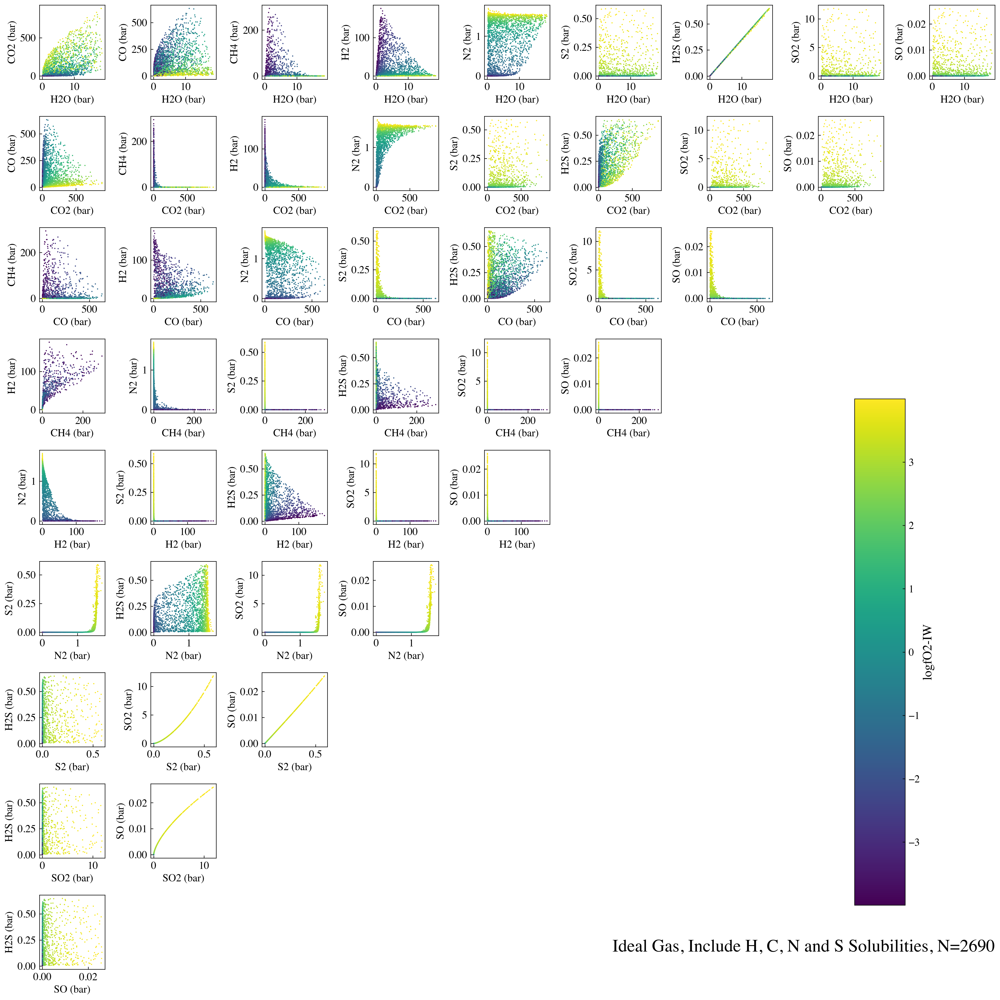

In [72]:
plot_pressures(T1e_Sols_soln, T1e_Sols_extra, 'Plots/T1e_HCONS_1500K_MF1_2000its_Sols.jpg', 'Ideal Gas, Include H, C, N and S Solubilities, N=2690')

/var/folders/48/rykhh41s6ds_xk4143_5pyv00000gn/T/ipykernel_19203/1399270916.py:279: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


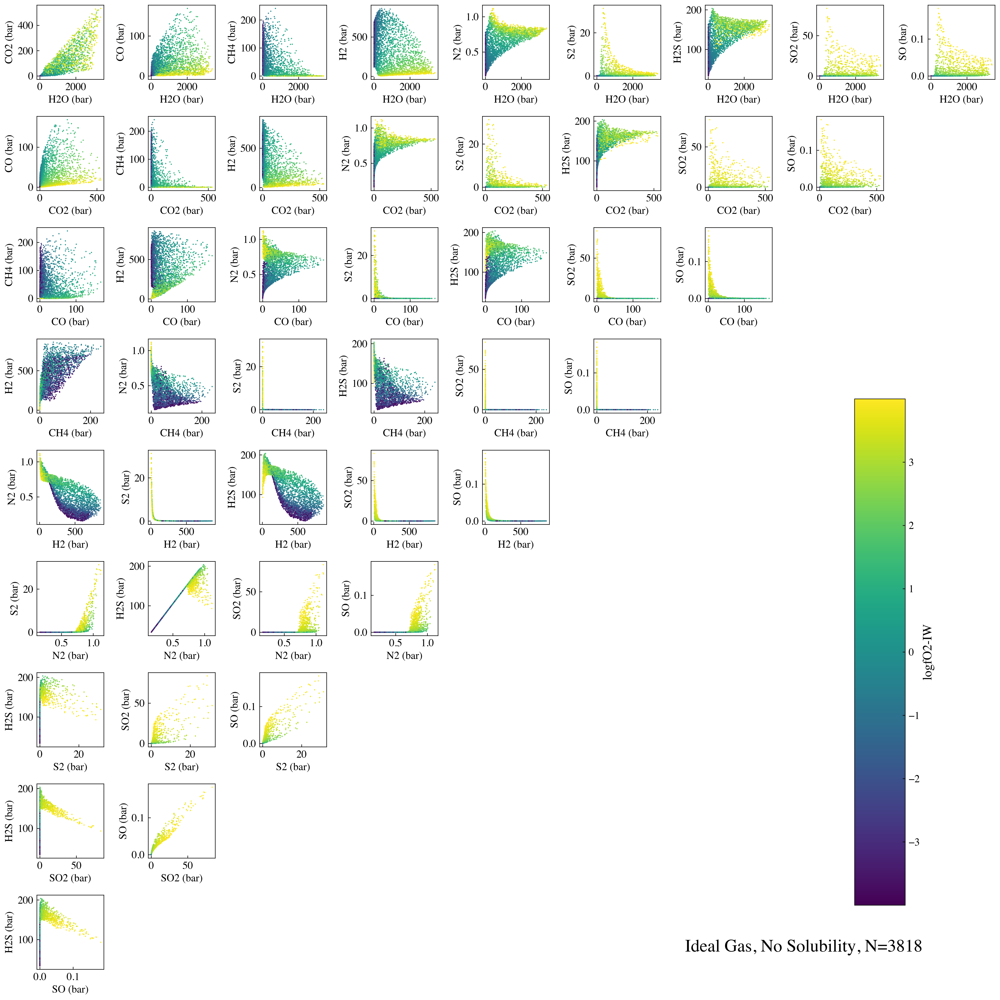

In [73]:
plot_pressures(T1e_NoSols_soln, T1e_NoSols_extra, 'Plots/T1e_HCONS_1500K_MF1_3800its_NoSols.jpg', 'Ideal Gas, No Solubility, N=3818')

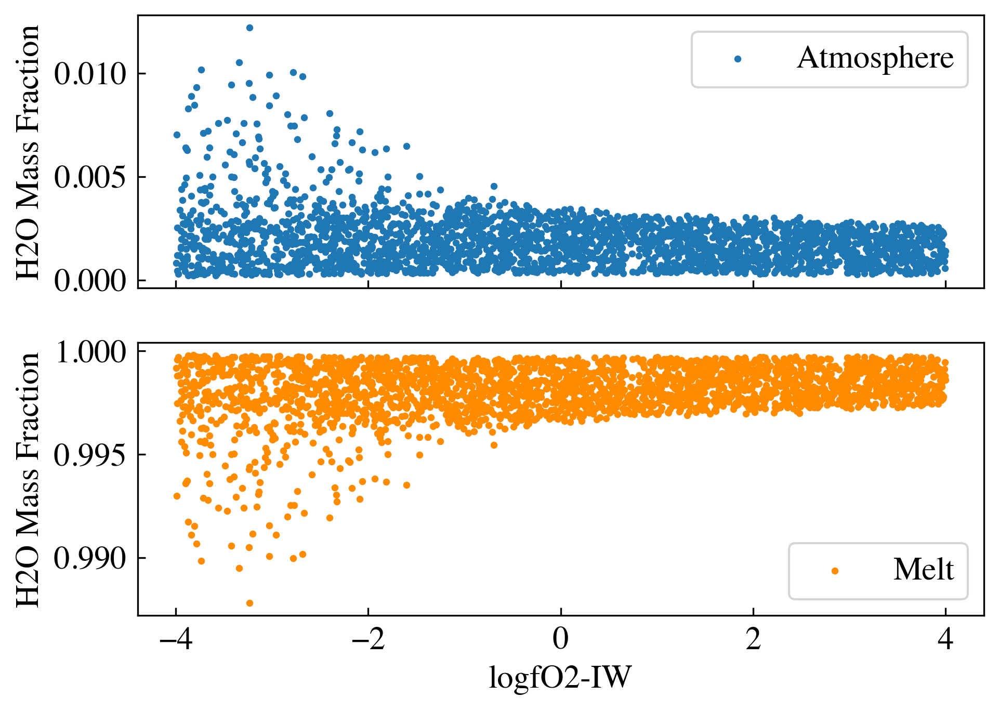

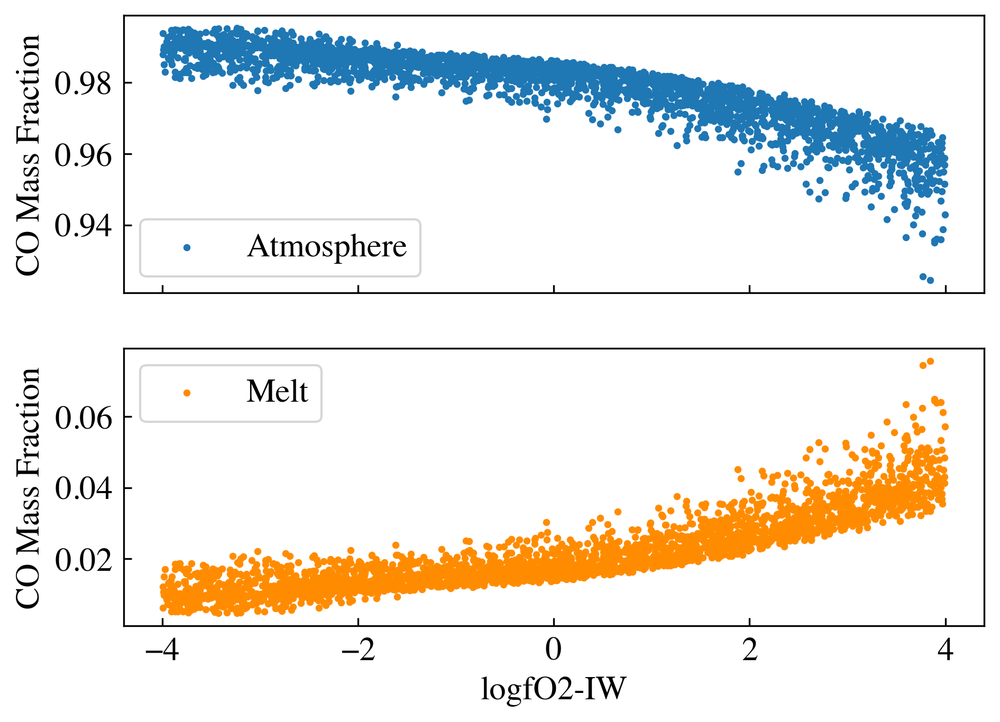

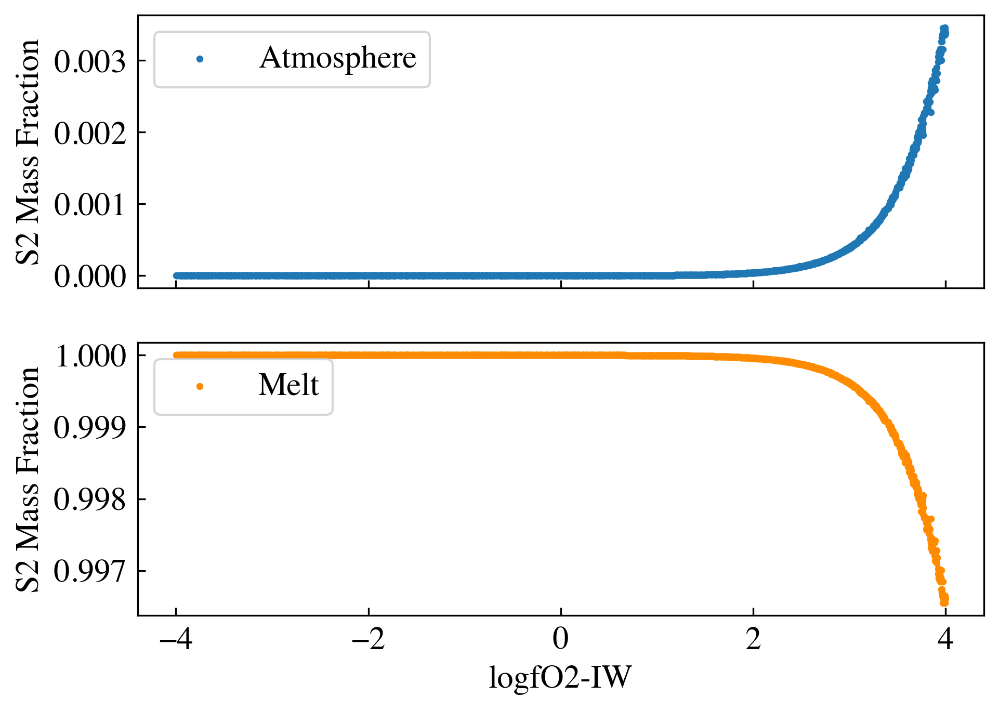

In [94]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True)
ax1.scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_H2O.mass_in_atmosphere/T1e_Sols_H2O.mass_in_total, s=5, label='Atmosphere')
ax2.scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_H2O.mass_in_melt/T1e_Sols_H2O.mass_in_total, s=5, color='darkorange', label='Melt')
ax1.set_ylabel('H2O Mass Fraction')
ax2.set_ylabel('H2O Mass Fraction')
ax1.legend()
ax2.legend()
plt.xlabel('logfO2-IW')
plt.show()

fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True)
ax1.scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_CO.mass_in_atmosphere/T1e_Sols_CO.mass_in_total, s=5, label='Atmosphere')
ax2.scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_CO.mass_in_melt/T1e_Sols_CO.mass_in_total, s=5, color='darkorange', label='Melt')
ax1.set_ylabel('CO Mass Fraction')
ax2.set_ylabel('CO Mass Fraction')
ax1.legend()
ax2.legend()
plt.xlabel('logfO2-IW')
plt.show()

fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True)
ax1.scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_S2.mass_in_atmosphere/T1e_Sols_S2.mass_in_total, s=5, label='Atmosphere')
ax2.scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_S2.mass_in_melt/T1e_Sols_S2.mass_in_total, s=5, color='darkorange', label='Melt')
ax1.set_ylabel('S2 Mass Fraction')
ax2.set_ylabel('S2 Mass Fraction')
ax1.legend()
ax2.legend()
plt.xlabel('logfO2-IW')
plt.show()

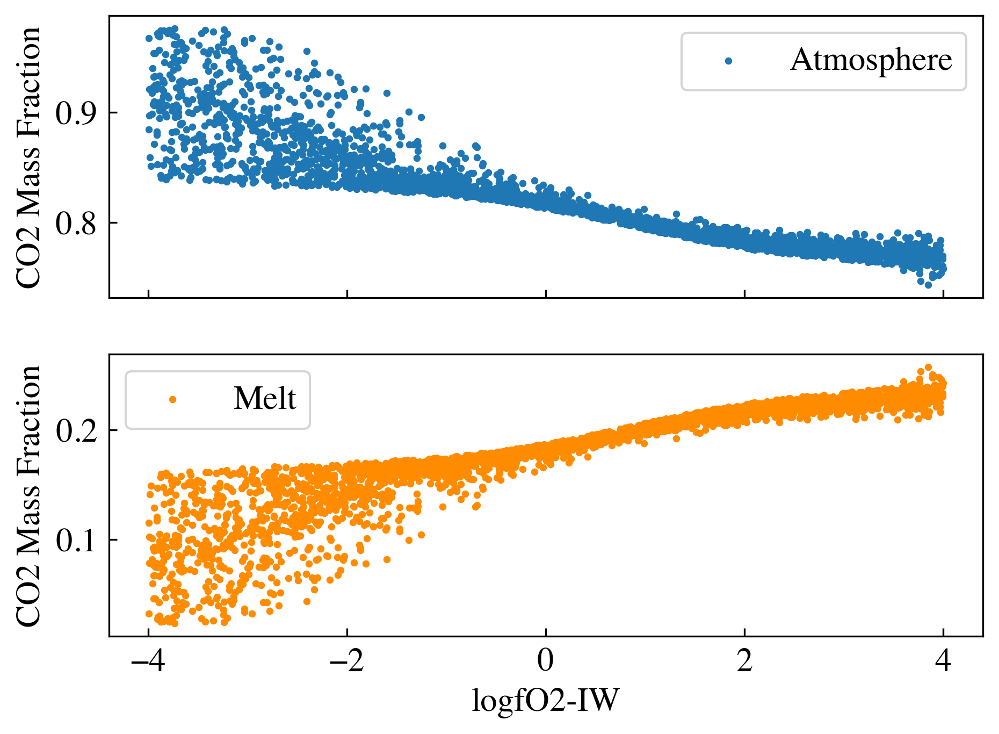

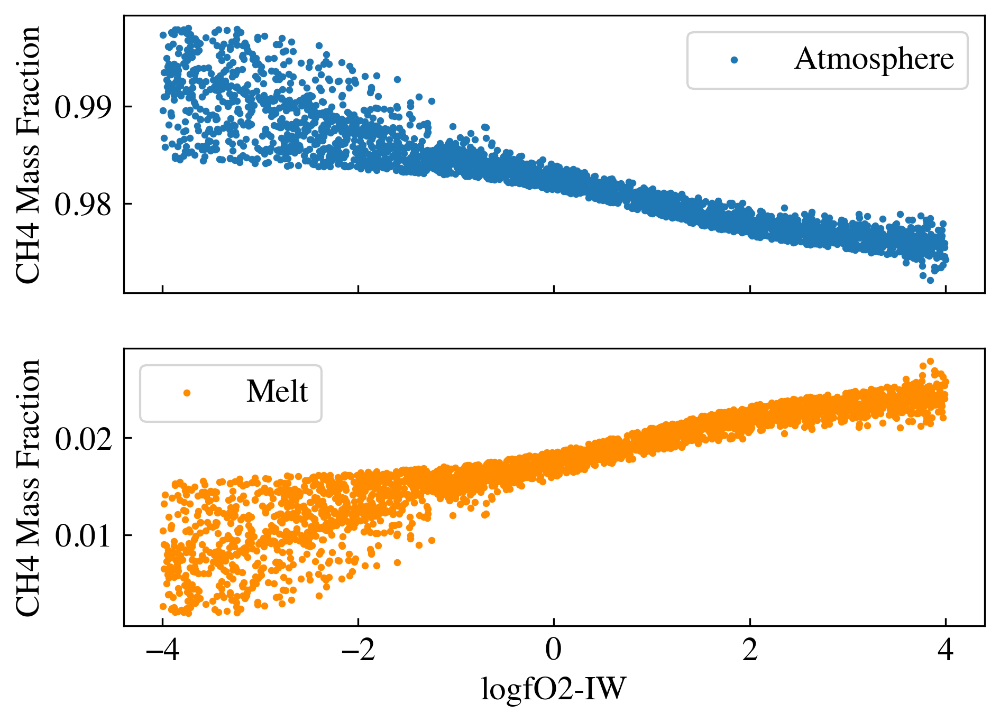

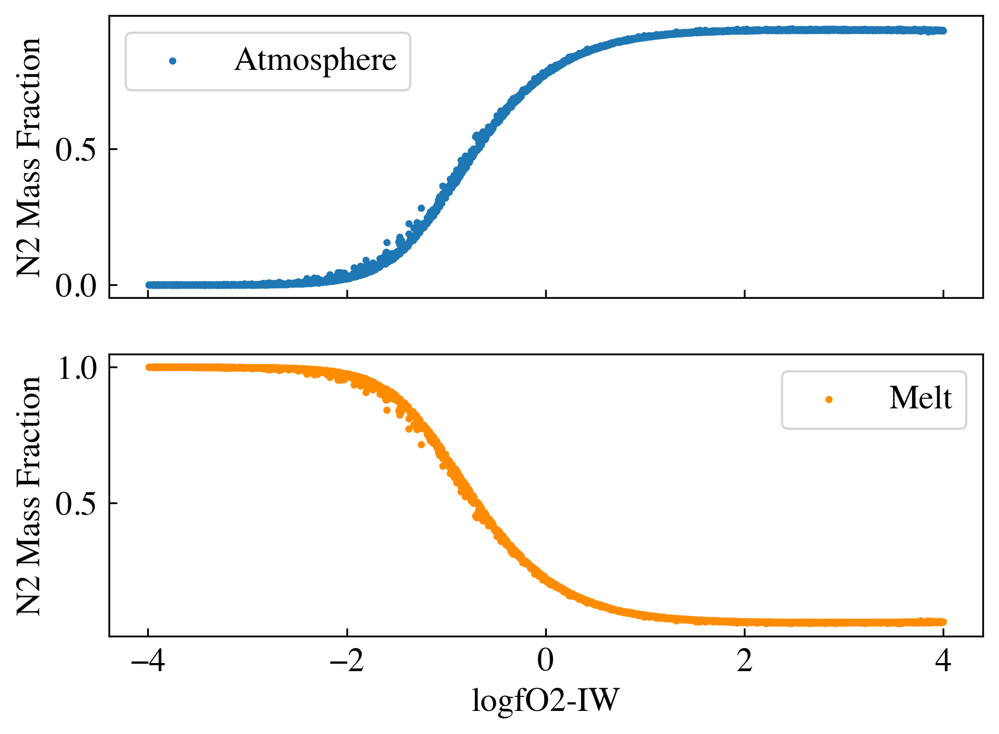

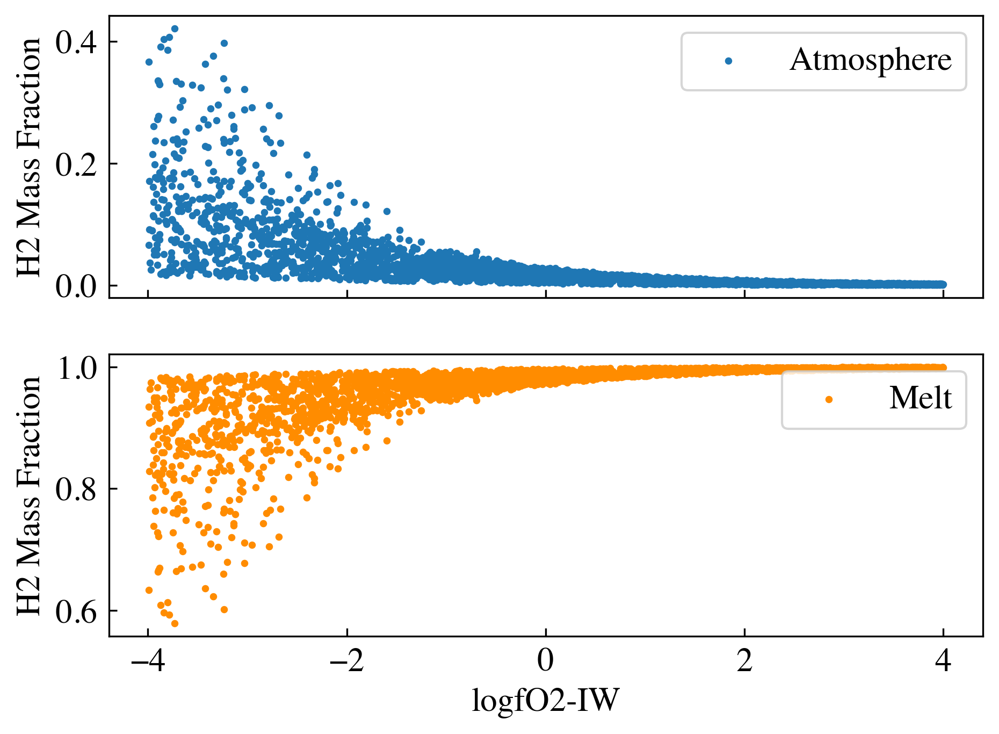

In [265]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True)
ax1.scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_CO2.mass_in_atmosphere/T1e_Sols_CO2.mass_in_total, s=5, label='Atmosphere')
ax2.scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_CO2.mass_in_melt/T1e_Sols_CO2.mass_in_total, s=5, color='darkorange', label='Melt')
ax1.set_ylabel('CO2 Mass Fraction')
ax2.set_ylabel('CO2 Mass Fraction')
ax1.legend()
ax2.legend()
plt.xlabel('logfO2-IW')
plt.show()

fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True)
ax1.scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_CH4.mass_in_atmosphere/T1e_Sols_CH4.mass_in_total, s=5, label='Atmosphere')
ax2.scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_CH4.mass_in_melt/T1e_Sols_CH4.mass_in_total, s=5, color='darkorange', label='Melt')
ax1.set_ylabel('CH4 Mass Fraction')
ax2.set_ylabel('CH4 Mass Fraction')
ax1.legend()
ax2.legend()
plt.xlabel('logfO2-IW')
plt.show()


fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True)
ax1.scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_N2.mass_in_atmosphere/T1e_Sols_N2.mass_in_total, s=5, label='Atmosphere')
ax2.scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_N2.mass_in_melt/T1e_Sols_N2.mass_in_total, s=5, color='darkorange', label='Melt')
ax1.set_ylabel('N2 Mass Fraction')
ax2.set_ylabel('N2 Mass Fraction')
ax1.legend()
ax2.legend()
plt.xlabel('logfO2-IW')
plt.show()

fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True)
ax1.scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_H2.mass_in_atmosphere/T1e_Sols_H2.mass_in_total, s=5, label='Atmosphere')
ax2.scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_H2.mass_in_melt/T1e_Sols_H2.mass_in_total, s=5, color='darkorange', label='Melt')
ax1.set_ylabel('H2 Mass Fraction')
ax2.set_ylabel('H2 Mass Fraction')
ax1.legend()
ax2.legend()
plt.xlabel('logfO2-IW')
plt.show()

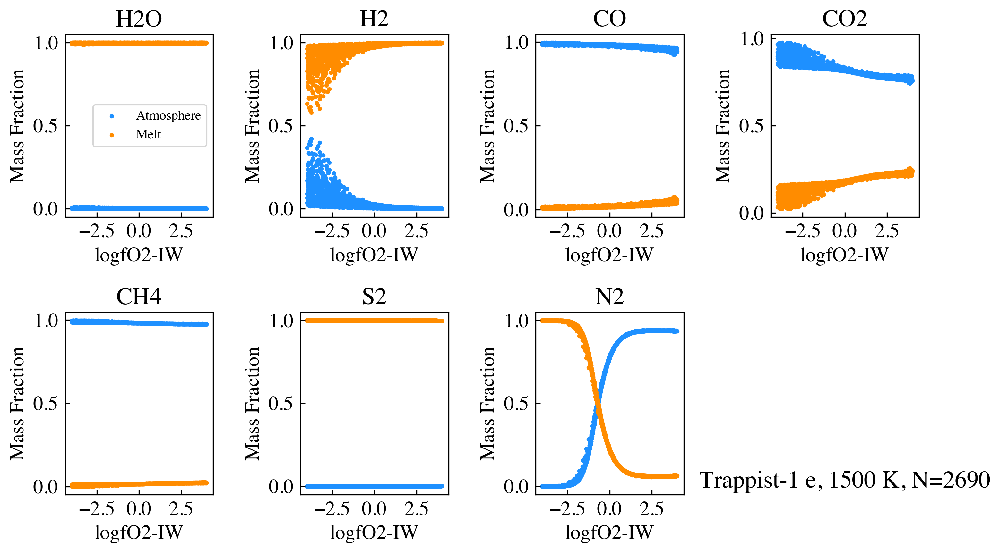

In [290]:
fig, ax = plt.subplots(figsize=(10,6), ncols=4, nrows=2)

ax[0,0].scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_H2O.mass_in_atmosphere/T1e_Sols_H2O.mass_in_total, s=5, color='dodgerblue', label='Atmosphere')
ax[0,0].scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_H2O.mass_in_melt/T1e_Sols_H2O.mass_in_total, s=5, color='darkorange', label='Melt')
ax[0,0].set_ylabel('Mass Fraction')
ax[0,0].legend(fontsize=10)
ax[0,0].set_title('H2O')
ax[0,0].set_xlabel('logfO2-IW')

ax[0,1].scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_H2.mass_in_atmosphere/T1e_Sols_H2.mass_in_total, s=5, color='dodgerblue', label='Atmosphere')
ax[0,1].scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_H2.mass_in_melt/T1e_Sols_H2.mass_in_total, s=5, color='darkorange', label='Melt')
ax[0,1].set_ylabel('Mass Fraction')
#ax[0,1].legend(fontsize=7)
ax[0,1].set_title('H2')
ax[0,1].set_xlabel('logfO2-IW')

ax[0,2].scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_CO.mass_in_atmosphere/T1e_Sols_CO.mass_in_total, s=5, color='dodgerblue', label='Atmosphere')
ax[0,2].scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_CO.mass_in_melt/T1e_Sols_CO.mass_in_total, s=5, color='darkorange', label='Melt')
ax[0,2].set_ylabel('Mass Fraction')
#ax[0,2].legend(fontsize=7)
ax[0,2].set_title('CO')
ax[0,2].set_xlabel('logfO2-IW')

ax[0,3].scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_CO2.mass_in_atmosphere/T1e_Sols_CO2.mass_in_total, s=5, color='dodgerblue', label='Atmosphere')
ax[0,3].scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_CO2.mass_in_melt/T1e_Sols_CO2.mass_in_total, s=5, color='darkorange', label='Melt')
ax[0,3].set_ylabel('Mass Fraction')
#ax[0,3].legend(fontsize=7)
ax[0,3].set_title('CO2')
ax[0,3].set_xlabel('logfO2-IW')

ax[1,0].scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_CH4.mass_in_atmosphere/T1e_Sols_CH4.mass_in_total, s=5, color='dodgerblue', label='Atmosphere')
ax[1,0].scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_CH4.mass_in_melt/T1e_Sols_CH4.mass_in_total, s=5, color='darkorange', label='Melt')
ax[1,0].set_ylabel('Mass Fraction')
#ax[1,0].legend(fontsize=7)
ax[1,0].set_title('CH4')
ax[1,0].set_xlabel('logfO2-IW')

ax[1,1].scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_S2.mass_in_atmosphere/T1e_Sols_S2.mass_in_total, s=5, color='dodgerblue', label='Atmosphere')
ax[1,1].scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_S2.mass_in_melt/T1e_Sols_S2.mass_in_total, s=5, color='darkorange', label='Melt')
ax[1,1].set_ylabel('Mass Fraction')
#ax[1,1].legend(fontsize=7)
ax[1,1].set_title('S2')
ax[1,1].set_xlabel('logfO2-IW')

ax[1,2].scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_N2.mass_in_atmosphere/T1e_Sols_N2.mass_in_total, s=5, color='dodgerblue', label='Atmosphere')
ax[1,2].scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_N2.mass_in_melt/T1e_Sols_N2.mass_in_total, s=5, color='darkorange', label='Melt')
ax[1,2].set_ylabel('Mass Fraction')
#ax[1,2].legend(fontsize=7)
ax[1,2].set_title('N2')
ax[1,2].set_xlabel('logfO2-IW')

ax[1, 3].axis('off')
plt.title('Trappist-1 e, 1500 K, N=2690', y=-0.005)
plt.tight_layout()
plt.savefig('Plots/T1e_HCONS_1500K_MF1_2000its_Sols_MassFrac.jpg', dpi=1000, bbox_inches='tight')
plt.show()

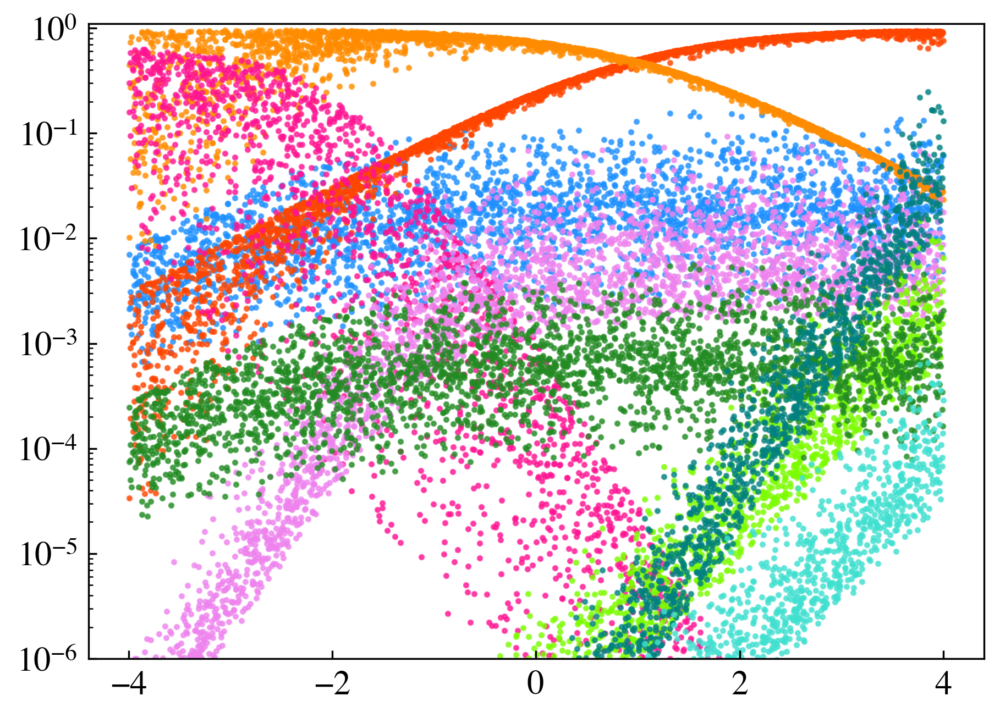

In [130]:
fig,ax=plt.subplots()
plt.scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_H2O.volume_mixing_ratio, color='dodgerblue', s=3, alpha=0.7)
plt.scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_CO2.volume_mixing_ratio, color='orangered', s=3, alpha=0.7)
plt.scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_CO.volume_mixing_ratio, color='darkorange', s=3, alpha=0.7)
plt.scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_CH4.volume_mixing_ratio, color='deeppink', s=3, alpha=0.7)
plt.scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_N2.volume_mixing_ratio, color='violet', s=3, alpha=0.7)
plt.scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_S2.volume_mixing_ratio, color='lawngreen', s=3, alpha=0.7)
plt.scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_H2S.volume_mixing_ratio, color='forestgreen', s=3, alpha=0.7)
plt.scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_SO2.volume_mixing_ratio, color='teal', s=3, alpha=0.7)
plt.scatter(T1e_Sols_extra.fO2_shift, T1e_Sols_SO.volume_mixing_ratio, color='turquoise', s=3, alpha=0.7)
plt.ylim(1e-6, 1.1)
plt.yscale('log')
plt.show()

In [254]:
T1e_NoSol_fO2Sorted = pd.read_excel('T1e_1500K_CHONS_AllIdeal_NoSols_3800_fO2Sorted.xlsx')
T1e_Sol_fO2Sorted = pd.read_excel('T1e_1500K_CHONS_AllIdeal_HCNSSol_2000its_2_fO2Sorted.xlsx')
print(len(T1e_Sol_fO2Sorted))

2690


In [260]:
n = 23

# calculates the average 
avg_fO2shift = np.average(np.array(T1e_NoSol_fO2Sorted.fO2_shift).reshape(-1, n), axis=1) 
avg_totalP = np.average(np.array(T1e_NoSol_fO2Sorted.total_pressure).reshape(-1, n), axis=1) 
avg_H2O = np.average(np.array(T1e_NoSol_fO2Sorted.H2O).reshape(-1, n), axis=1) 
avg_H2 = np.average(np.array(T1e_NoSol_fO2Sorted.H2).reshape(-1, n), axis=1) 
avg_CO2 = np.average(np.array(T1e_NoSol_fO2Sorted.CO2).reshape(-1, n), axis=1) 
avg_CO = np.average(np.array(T1e_NoSol_fO2Sorted.CO).reshape(-1, n), axis=1) 
avg_CH4 = np.average(np.array(T1e_NoSol_fO2Sorted.CH4).reshape(-1, n), axis=1) 
avg_N2 = np.average(np.array(T1e_NoSol_fO2Sorted.N2).reshape(-1, n), axis=1) 
avg_S2 = np.average(np.array(T1e_NoSol_fO2Sorted.S2).reshape(-1, n), axis=1) 
avg_H2S = np.average(np.array(T1e_NoSol_fO2Sorted.H2S).reshape(-1, n), axis=1) 
avg_SO2 = np.average(np.array(T1e_NoSol_fO2Sorted.SO2).reshape(-1, n), axis=1) 
avg_SO = np.average(np.array(T1e_NoSol_fO2Sorted.SO).reshape(-1, n), axis=1) 

H2O_std = np.std(avg_H2O/avg_totalP)
H2_std = np.std(avg_H2/avg_totalP)
CO2_std = np.std(avg_CO2/avg_totalP)
CO_std = np.std(avg_CO/avg_totalP)
CH4_std = np.std(avg_CH4/avg_totalP)
N2_std = np.std(avg_N2/avg_totalP)
S2_std = np.std(avg_S2/avg_totalP)
H2S_std = np.std(avg_H2S/avg_totalP)
SO2_std = np.std(avg_SO2/avg_totalP)
SO_std = np.std(avg_SO/avg_totalP)

H2O_std_2 = np.std(T1e_NoSol_fO2Sorted.H2O/T1e_NoSol_fO2Sorted.total_pressure)
print(H2O_std)

0.3186063402799113


In [256]:
n = 10

# calculates the average 
avg_fO2shift_Sol = np.average(np.array(T1e_Sol_fO2Sorted.fO2_shift).reshape(-1, n), axis=1) 
avg_totalP_Sol = np.average(np.array(T1e_Sol_fO2Sorted.total_pressure).reshape(-1, n), axis=1) 
avg_H2O_Sol = np.average(np.array(T1e_Sol_fO2Sorted.H2O).reshape(-1, n), axis=1) 
avg_H2_Sol = np.average(np.array(T1e_Sol_fO2Sorted.H2).reshape(-1, n), axis=1) 
avg_CO2_Sol = np.average(np.array(T1e_Sol_fO2Sorted.CO2).reshape(-1, n), axis=1) 
avg_CO_Sol = np.average(np.array(T1e_Sol_fO2Sorted.CO).reshape(-1, n), axis=1) 
avg_CH4_Sol = np.average(np.array(T1e_Sol_fO2Sorted.CH4).reshape(-1, n), axis=1) 
avg_N2_Sol = np.average(np.array(T1e_Sol_fO2Sorted.N2).reshape(-1, n), axis=1) 
avg_S2_Sol = np.average(np.array(T1e_Sol_fO2Sorted.S2).reshape(-1, n), axis=1) 
avg_H2S_Sol = np.average(np.array(T1e_Sol_fO2Sorted.H2S).reshape(-1, n), axis=1) 
avg_SO2_Sol = np.average(np.array(T1e_Sol_fO2Sorted.SO2).reshape(-1, n), axis=1) 
avg_SO_Sol = np.average(np.array(T1e_Sol_fO2Sorted.SO).reshape(-1, n), axis=1) 

H2O_std_Sol = np.std(avg_H2O_Sol/avg_totalP_Sol)
H2_std_Sol = np.std(avg_H2_Sol/avg_totalP_Sol)
CO2_std_Sol = np.std(avg_CO2_Sol/avg_totalP_Sol)
CO_std_Sol = np.std(avg_CO_Sol/avg_totalP_Sol)
CH4_std_Sol = np.std(avg_CH4_Sol/avg_totalP_Sol)
N2_std_Sol = np.std(avg_N2_Sol/avg_totalP_Sol)
S2_std_Sol = np.std(avg_S2_Sol/avg_totalP_Sol)
H2S_std_Sol = np.std(avg_H2S_Sol/avg_totalP_Sol)
SO2_std_Sol = np.std(avg_SO2_Sol/avg_totalP_Sol)
SO_std_Sol = np.std(avg_SO_Sol/avg_totalP_Sol)



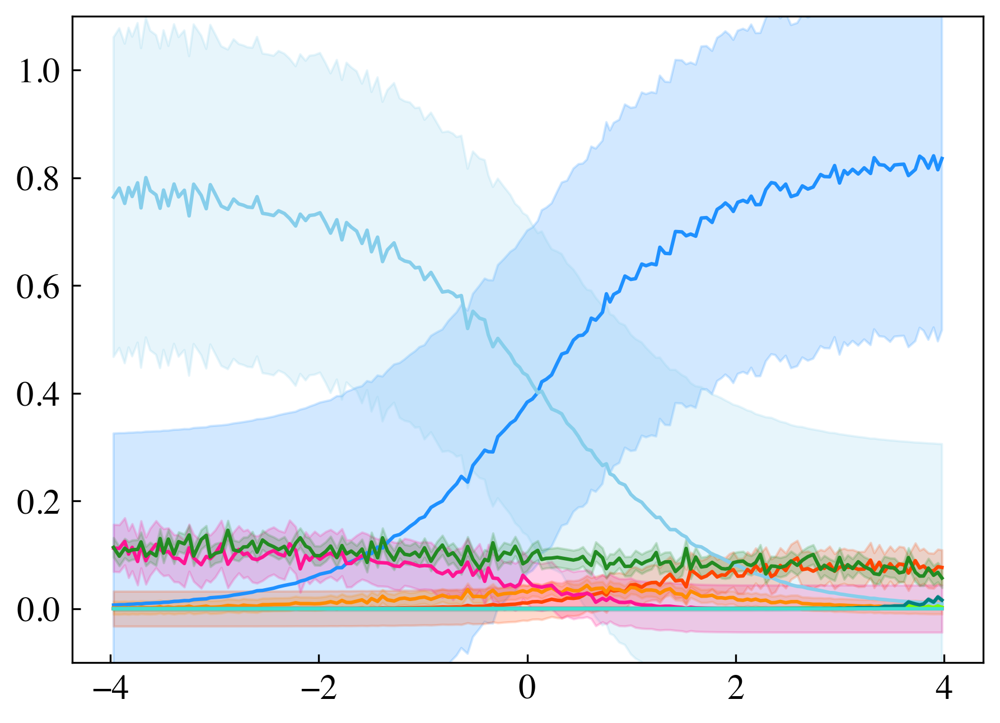

In [261]:
fig, ax = plt.subplots()
plt.plot(avg_fO2shift, avg_H2O/avg_totalP, color='dodgerblue')
plt.fill_between(avg_fO2shift, (avg_H2O/avg_totalP) - H2O_std, (avg_H2O/avg_totalP) + H2O_std,
                 color='dodgerblue', alpha=0.2)

plt.plot(avg_fO2shift, avg_H2/avg_totalP, color='skyblue')
plt.fill_between(avg_fO2shift, (avg_H2/avg_totalP) - H2_std, (avg_H2/avg_totalP) + H2_std,
                 color='skyblue', alpha=0.2)

plt.plot(avg_fO2shift, avg_CO2/avg_totalP, color='orangered')
plt.fill_between(avg_fO2shift, (avg_CO2/avg_totalP) - CO2_std, (avg_CO2/avg_totalP) + CO2_std,
                 color='orangered', alpha=0.2)
plt.plot(avg_fO2shift, avg_CO/avg_totalP, color='darkorange')
plt.fill_between(avg_fO2shift, (avg_CO/avg_totalP) - CO_std, (avg_CO/avg_totalP) + CO_std,
                 color='darkorange', alpha=0.2)
plt.plot(avg_fO2shift, avg_CH4/avg_totalP, color='deeppink')
plt.fill_between(avg_fO2shift, (avg_CH4/avg_totalP) - CH4_std, (avg_CH4/avg_totalP) + CH4_std,
                 color='deeppink', alpha=0.2)
plt.plot(avg_fO2shift, avg_N2/avg_totalP, color='violet')
plt.fill_between(avg_fO2shift, (avg_N2/avg_totalP) - N2_std, (avg_N2/avg_totalP) + N2_std,
                 color='violet', alpha=0.2)
plt.plot(avg_fO2shift, avg_S2/avg_totalP, color='lawngreen')
plt.fill_between(avg_fO2shift, (avg_S2/avg_totalP) - S2_std, (avg_S2/avg_totalP) + S2_std,
                 color='lawngreen', alpha=0.2)
plt.plot(avg_fO2shift, avg_H2S/avg_totalP, color='forestgreen')
plt.fill_between(avg_fO2shift, (avg_H2S/avg_totalP) - H2S_std, (avg_H2S/avg_totalP) + H2S_std,
                 color='forestgreen', alpha=0.2)
plt.plot(avg_fO2shift, avg_SO2/avg_totalP, color='teal')
plt.fill_between(avg_fO2shift, (avg_SO2/avg_totalP) - SO2_std, (avg_SO2/avg_totalP) + SO2_std,
                 color='teal', alpha=0.2)
plt.plot(avg_fO2shift, avg_SO/avg_totalP, color='turquoise')
plt.fill_between(avg_fO2shift, (avg_SO/avg_totalP) - SO_std, (avg_SO/avg_totalP) + SO_std,
                 color='turquoise', alpha=0.2)
plt.ylim(-0.1, 1.1)
#plt.yscale('log')
plt.show()

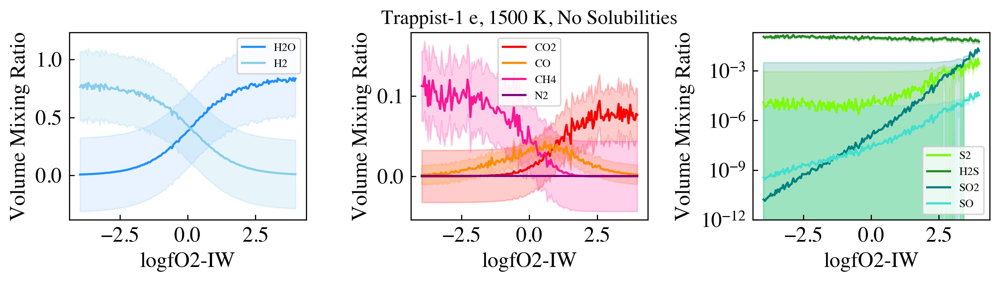

In [316]:
fig, ax = plt.subplots(figsize=(10, 3), ncols=3, nrows=1)
ax[0].plot(avg_fO2shift, avg_H2O/avg_totalP, color='dodgerblue', label='H2O')
ax[0].fill_between(avg_fO2shift, (avg_H2O/avg_totalP) - H2O_std, (avg_H2O/avg_totalP) + H2O_std,
                 color='dodgerblue', alpha=0.1)


ax[0].plot(avg_fO2shift, avg_H2/avg_totalP, color='skyblue', label='H2')
ax[0].fill_between(avg_fO2shift, (avg_H2/avg_totalP) - H2_std, (avg_H2/avg_totalP) + H2_std,
                 color='skyblue', alpha=0.2)

ax[0].set_ylabel('Volume Mixing Ratio')
ax[0].set_xlabel('logfO2-IW')
ax[0].legend(fontsize=8)

ax[1].plot(avg_fO2shift, avg_CO2/avg_totalP, color='red', label='CO2')
ax[1].fill_between(avg_fO2shift, (avg_CO2/avg_totalP) - CO2_std, (avg_CO2/avg_totalP) + CO2_std,
                 color='red', alpha=0.2)

ax[1].plot(avg_fO2shift, avg_CO/avg_totalP, color='darkorange', label='CO')
ax[1].fill_between(avg_fO2shift, (avg_CO/avg_totalP) - CO_std, (avg_CO/avg_totalP) + CO_std,
                 color='darkorange', alpha=0.2)

ax[1].plot(avg_fO2shift, avg_CH4/avg_totalP, color='deeppink', label='CH4')
ax[1].fill_between(avg_fO2shift, (avg_CH4/avg_totalP) - CH4_std, (avg_CH4/avg_totalP) + CH4_std,
                 color='deeppink', alpha=0.2)

ax[1].plot(avg_fO2shift, avg_N2/avg_totalP, color='purple', label='N2')
ax[1].fill_between(avg_fO2shift, (avg_N2/avg_totalP) - N2_std, (avg_N2/avg_totalP) + N2_std,
                 color='purple', alpha=0.2)

ax[1].set_ylabel('Volume Mixing Ratio')
ax[1].set_xlabel('logfO2-IW')
ax[1].legend(fontsize=8)

ax[2].plot(avg_fO2shift, avg_S2/avg_totalP, color='lawngreen', label='S2')
ax[2].fill_between(avg_fO2shift, (avg_S2/avg_totalP) - S2_std, (avg_S2/avg_totalP) + S2_std,
                 color='lawngreen', alpha=0.2)
ax[2].plot(avg_fO2shift, avg_H2S/avg_totalP, color='forestgreen', label='H2S')
ax[2].fill_between(avg_fO2shift, (avg_H2S/avg_totalP) - H2S_std, (avg_H2S/avg_totalP) + H2S_std,
                 color='forestgreen', alpha=0.2)
ax[2].plot(avg_fO2shift, avg_SO2/avg_totalP, color='teal', label='SO2')
ax[2].fill_between(avg_fO2shift, (avg_SO2/avg_totalP) - SO2_std, (avg_SO2/avg_totalP) + SO2_std,
                 color='teal', alpha=0.2)
ax[2].plot(avg_fO2shift, avg_SO/avg_totalP, color='turquoise', label='SO')
ax[2].fill_between(avg_fO2shift, (avg_SO/avg_totalP) - SO_std, (avg_SO/avg_totalP) + SO_std,
                 color='turquoise', alpha=0.2)

ax[2].set_ylabel('Volume Mixing Ratio')
ax[2].set_xlabel('logfO2-IW')
ax[2].legend(fontsize=8)
ax[2].set_ylim(1e-12,0.2)
ax[2].set_yscale('log')
#plt.ylim(1e-6, 1.1)
#plt.yscale('log')
ax[1].set_title('Trappist-1 e, 1500 K, No Solubilities', fontsize=14)

plt.tight_layout()
plt.savefig('Plots/T1e_1500K_CHONS_AllIdeal_NoSols_AvgVMRswithSTD.jpg', dpi=1000, bbox_inches='tight')
plt.show()

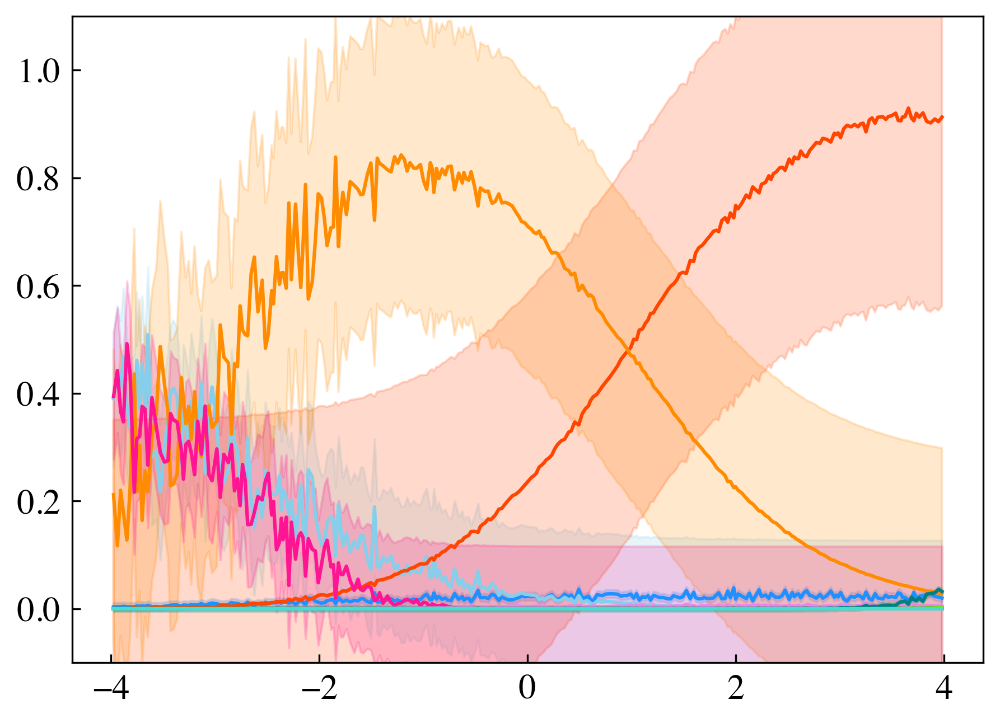

In [263]:
#Solubility

fig, ax = plt.subplots()
plt.plot(avg_fO2shift_Sol, avg_H2O_Sol/avg_totalP_Sol, color='dodgerblue')
plt.fill_between(avg_fO2shift_Sol, (avg_H2O_Sol/avg_totalP_Sol) - H2O_std_Sol, (avg_H2O_Sol/avg_totalP_Sol) + H2O_std_Sol,
                 color='dodgerblue', alpha=0.2)

plt.plot(avg_fO2shift_Sol, avg_H2_Sol/avg_totalP_Sol, color='skyblue')
plt.fill_between(avg_fO2shift_Sol, (avg_H2_Sol/avg_totalP_Sol) - H2_std_Sol, (avg_H2_Sol/avg_totalP_Sol) + H2_std_Sol,
                 color='skyblue', alpha=0.2)

plt.plot(avg_fO2shift_Sol, avg_CO2_Sol/avg_totalP_Sol, color='orangered')
plt.fill_between(avg_fO2shift_Sol, (avg_CO2_Sol/avg_totalP_Sol) - CO2_std_Sol, (avg_CO2_Sol/avg_totalP_Sol) + CO2_std_Sol,
                 color='orangered', alpha=0.2)

plt.plot(avg_fO2shift_Sol, avg_CO_Sol/avg_totalP_Sol, color='darkorange')
plt.fill_between(avg_fO2shift_Sol, (avg_CO_Sol/avg_totalP_Sol) - CO_std_Sol, (avg_CO_Sol/avg_totalP_Sol) + CO_std_Sol,
                 color='darkorange', alpha=0.2)

plt.plot(avg_fO2shift_Sol, avg_CH4_Sol/avg_totalP_Sol, color='deeppink')
plt.fill_between(avg_fO2shift_Sol, (avg_CH4_Sol/avg_totalP_Sol) - CH4_std_Sol, (avg_CH4_Sol/avg_totalP_Sol) + CH4_std_Sol,
                 color='deeppink', alpha=0.2)

plt.plot(avg_fO2shift_Sol, avg_N2_Sol/avg_totalP_Sol, color='violet')
plt.fill_between(avg_fO2shift_Sol, (avg_N2_Sol/avg_totalP_Sol) - N2_std_Sol, (avg_N2_Sol/avg_totalP_Sol) + N2_std_Sol,
                 color='violet', alpha=0.2)

plt.plot(avg_fO2shift_Sol, avg_S2_Sol/avg_totalP_Sol, color='lawngreen')
plt.fill_between(avg_fO2shift_Sol, (avg_S2_Sol/avg_totalP_Sol) - S2_std_Sol, (avg_S2_Sol/avg_totalP_Sol) + S2_std_Sol,
                 color='lawngreen', alpha=0.2)

plt.plot(avg_fO2shift_Sol, avg_H2S_Sol/avg_totalP_Sol, color='forestgreen')
plt.fill_between(avg_fO2shift_Sol, (avg_H2S_Sol/avg_totalP_Sol) - H2S_std_Sol, (avg_H2S_Sol/avg_totalP_Sol) + H2S_std_Sol,
                 color='forestgreen', alpha=0.2)

plt.plot(avg_fO2shift_Sol, avg_SO2_Sol/avg_totalP_Sol, color='teal')
plt.fill_between(avg_fO2shift_Sol, (avg_SO2_Sol/avg_totalP_Sol) - SO2_std_Sol, (avg_SO2_Sol/avg_totalP_Sol) + SO2_std_Sol,
                 color='teal', alpha=0.2)

plt.plot(avg_fO2shift_Sol, avg_SO_Sol/avg_totalP_Sol, color='turquoise')
plt.fill_between(avg_fO2shift_Sol, (avg_SO_Sol/avg_totalP_Sol) - SO_std_Sol, (avg_SO_Sol/avg_totalP_Sol) + SO_std_Sol,
                 color='turquoise', alpha=0.2)
plt.ylim(-0.1, 1.1)
#plt.yscale('log')
plt.show()

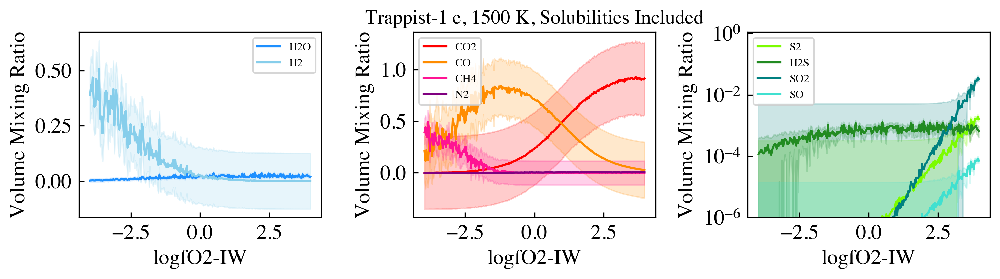

In [315]:
fig, ax = plt.subplots(figsize=(10, 3), ncols=3, nrows=1)
ax[0].plot(avg_fO2shift_Sol, avg_H2O_Sol/avg_totalP_Sol, color='dodgerblue', label='H2O')
ax[0].fill_between(avg_fO2shift_Sol, (avg_H2O_Sol/avg_totalP_Sol) - H2O_std_Sol, (avg_H2O_Sol/avg_totalP_Sol) + H2O_std_Sol,
                 color='dodgerblue', alpha=0.1)


ax[0].plot(avg_fO2shift_Sol, avg_H2_Sol/avg_totalP_Sol, color='skyblue', label='H2')
ax[0].fill_between(avg_fO2shift_Sol, (avg_H2_Sol/avg_totalP_Sol) - H2_std_Sol, (avg_H2_Sol/avg_totalP_Sol) + H2_std_Sol,
                 color='skyblue', alpha=0.2)

ax[0].set_ylabel('Volume Mixing Ratio')
ax[0].set_xlabel('logfO2-IW')
ax[0].legend(fontsize=8)

ax[1].plot(avg_fO2shift_Sol, avg_CO2_Sol/avg_totalP_Sol, color='red', label='CO2')
ax[1].fill_between(avg_fO2shift_Sol, (avg_CO2_Sol/avg_totalP_Sol) - CO2_std_Sol, (avg_CO2_Sol/avg_totalP_Sol) + CO2_std_Sol,
                 color='red', alpha=0.2)

ax[1].plot(avg_fO2shift_Sol, avg_CO_Sol/avg_totalP_Sol, color='darkorange', label='CO')
ax[1].fill_between(avg_fO2shift_Sol, (avg_CO_Sol/avg_totalP_Sol) - CO_std_Sol, (avg_CO_Sol/avg_totalP_Sol) + CO_std_Sol,
                 color='darkorange', alpha=0.2)

ax[1].plot(avg_fO2shift_Sol, avg_CH4_Sol/avg_totalP_Sol, color='deeppink', label='CH4')
ax[1].fill_between(avg_fO2shift_Sol, (avg_CH4_Sol/avg_totalP_Sol) - CH4_std_Sol, (avg_CH4_Sol/avg_totalP_Sol) + CH4_std_Sol,
                 color='deeppink', alpha=0.2)

ax[1].plot(avg_fO2shift_Sol, avg_N2_Sol/avg_totalP_Sol, color='purple', label='N2')
ax[1].fill_between(avg_fO2shift_Sol, (avg_N2_Sol/avg_totalP_Sol) - N2_std_Sol, (avg_N2_Sol/avg_totalP_Sol) + N2_std_Sol,
                 color='purple', alpha=0.2)

ax[1].set_ylabel('Volume Mixing Ratio')
ax[1].set_xlabel('logfO2-IW')
ax[1].legend(fontsize=8)

ax[2].plot(avg_fO2shift_Sol, avg_S2_Sol/avg_totalP_Sol, color='lawngreen', label='S2')
ax[2].fill_between(avg_fO2shift_Sol, (avg_S2_Sol/avg_totalP_Sol) - S2_std_Sol, (avg_S2_Sol/avg_totalP_Sol) + S2_std_Sol,
                 color='lawngreen', alpha=0.2)
ax[2].plot(avg_fO2shift_Sol, avg_H2S_Sol/avg_totalP_Sol, color='forestgreen', label='H2S')
ax[2].fill_between(avg_fO2shift_Sol, (avg_H2S_Sol/avg_totalP_Sol) - H2S_std_Sol, (avg_H2S_Sol/avg_totalP_Sol) + H2S_std_Sol,
                 color='forestgreen', alpha=0.2)
ax[2].plot(avg_fO2shift_Sol, avg_SO2_Sol/avg_totalP_Sol, color='teal', label='SO2')
ax[2].fill_between(avg_fO2shift_Sol, (avg_SO2_Sol/avg_totalP_Sol) - SO2_std_Sol, (avg_SO2_Sol/avg_totalP_Sol) + SO2_std_Sol,
                 color='teal', alpha=0.2)
ax[2].plot(avg_fO2shift_Sol, avg_SO_Sol/avg_totalP_Sol, color='turquoise', label='SO')
ax[2].fill_between(avg_fO2shift_Sol, (avg_SO_Sol/avg_totalP_Sol) - SO_std_Sol, (avg_SO_Sol/avg_totalP_Sol) + SO_std_Sol,
                 color='turquoise', alpha=0.2)

ax[2].set_ylabel('Volume Mixing Ratio')
ax[2].set_xlabel('logfO2-IW')
ax[2].legend(fontsize=8)
#ax[2].set_ylim(1e-12,0.2)
ax[2].set_yscale('log')
plt.ylim(1e-6, 1.1)
#plt.yscale('log')
ax[1].set_title('Trappist-1 e, 1500 K, Solubilities Included', fontsize=14)

plt.tight_layout()
plt.savefig('Plots/T1e_1500K_CHONS_AllIdeal_HCNSSols_AvgVMRswithSTD.jpg', dpi=1000, bbox_inches='tight')
plt.show()